# Исследование рынка заведений общественного питания Москвы

<h1>Содержание<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Обзор-данных" data-toc-modified-id="Обзор-данных-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Обзор данных</a></span></li><li><span><a href="#Предобработка-данных" data-toc-modified-id="Предобработка-данных-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Предобработка данных</a></span><ul class="toc-item"><li><span><a href="#Дубликаты" data-toc-modified-id="Дубликаты-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Дубликаты</a></span></li><li><span><a href="#Пропуски" data-toc-modified-id="Пропуски-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Пропуски</a></span></li><li><span><a href="#Артефакты-и-выбросы" data-toc-modified-id="Артефакты-и-выбросы-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Артефакты и выбросы</a></span></li><li><span><a href="#Добавление-столбцов" data-toc-modified-id="Добавление-столбцов-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Добавление столбцов</a></span></li></ul></li><li><span><a href="#Исследовательский-анализ-данных" data-toc-modified-id="Исследовательский-анализ-данных-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Исследовательский анализ данных</a></span><ul class="toc-item"><li><span><a href="#Распределение-заведений-по-категориям-и-принадлежности-к-сетям" data-toc-modified-id="Распределение-заведений-по-категориям-и-принадлежности-к-сетям-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Распределение заведений по категориям и принадлежности к сетям</a></span></li><li><span><a href="#Особенности-географического-распределения-заведений" data-toc-modified-id="Особенности-географического-распределения-заведений-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Особенности географического распределения заведений</a></span></li></ul></li><li><span><a href="#Определение-основных-характеристик-для-новой-кофейни" data-toc-modified-id="Определение-основных-характеристик-для-новой-кофейни-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Определение основных характеристик для новой кофейни</a></span><ul class="toc-item"><li><span><a href="#Географическое-распределение-кофеен" data-toc-modified-id="Географическое-распределение-кофеен-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Географическое распределение кофеен</a></span></li><li><span><a href="#Круглосуточные-кофейни" data-toc-modified-id="Круглосуточные-кофейни-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Круглосуточные кофейни</a></span></li><li><span><a href="#Рейтинги-кофеен" data-toc-modified-id="Рейтинги-кофеен-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>Рейтинги кофеен</a></span></li><li><span><a href="#Средние-цены-кофеен" data-toc-modified-id="Средние-цены-кофеен-4.4"><span class="toc-item-num">4.4&nbsp;&nbsp;</span>Средние цены кофеен</a></span></li></ul></li><li><span><a href="#Выводы-и-рекомендации" data-toc-modified-id="Выводы-и-рекомендации-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Выводы и рекомендации</a></span></li></ul></div>

Исследование проводится для фонда «Shut Up and Take My Money». В ходе исследования рассматривается рынок общественного питания Москвы — анализируются его особенности, в частности в сегменте кофеен, и выдвигаются рекомендации по выбору места, режима работы и средних цен для новой кофейни.

**Цель исследования** — выявление особенностей рынка общественного питания Москвы.

*Задачи исследования*:

- определить характеристики распределения заведений по категориям и принадлежности к сетям,

- определить характеристики распределения посадочных мест по категориям,

- определить характеристики географического распределения заведений,

- определить характеристики географического распределения средних рейтингов,

- определить характеристики географического распределения средних цен,

- выявить особенности сегмента кофеен,

- дать рекомендации по открытию кофейни в Москве в отношении места, режима работа и средней цены чашки капучино.

*Этапы исследования*:

- предобработка данных: удаление дубликатов, обработка пропусков и артефактов, включение дополнительных столбцов;

- исследовательский анализ данных: изучение распределение заведений по категориям и сетевой принадлежности, в том числе через призму количества посадочных мест и средних рейтингов;

- изучение сегмента кофеен: анализ географического распределения кофеен, определение доли круглосуточных кофеен, изучение рейтингов и средних цен кофеен.

*Источник данных* — информация из сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.

*Презентация* — по [ссылке](https://disk.yandex.ru/i/BWYUmDALhRRwkw).

## Обзор данных

In [1]:
!pip install -U iuliia
!pip install -U folium

from plotly import graph_objects as go
from matplotlib.ticker import MultipleLocator
from matplotlib import pyplot as plt
from folium.plugins import MarkerCluster
from folium.features import CustomIcon
from folium import Map, Marker, Choropleth, Element
import seaborn as sns
import re
import plotly.express as px
import pandas as pd
import os
import numpy as np
import math as mth
import iuliia

%matplotlib inline

Откроем сохраним данные о московских заведениях общественного питания в переменную `rest_data`. Просмотрим его первые пять строк.

In [2]:
pth_local = 'moscow_places.csv'
pth_global = '/datasets/moscow_places.csv'

if os.path.exists(pth_local):
    rest_data = pd.read_csv(pth_local)
elif os.path.exists(pth_global):
    rest_data = pd.read_csv(pth_global)
else:
    print('Исходные данные не найдены!')

rest_data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Информация о столбцах таблицы:

`name` — название заведения;

`address` — адрес заведения;

`category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;

`hours` — информация о днях и часах работы;

`lat` — широта географической точки, в которой находится заведение;

`lng` — долгота географической точки, в которой находится заведение;

`rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);

`price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;

`avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:

- «Средний счёт: 1000–1500 ₽»;
- «Цена чашки капучино: 130–220 ₽»;
- «Цена бокала пива: 400–600 ₽» и так далее;

`middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:

- Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
- Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
- Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.

`middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:

- Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
- Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
- Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.

`chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);

`district` — административный район, в котором находится заведение, например Центральный административный округ;

`seats` — количество посадочных мест.

Просмотрим общую информацию о датасете:

In [3]:
rest_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Взглянем на статистическую информацию о числовых столбцах:

In [4]:
rest_data.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


Построим гистограммы по числовым столбцам:

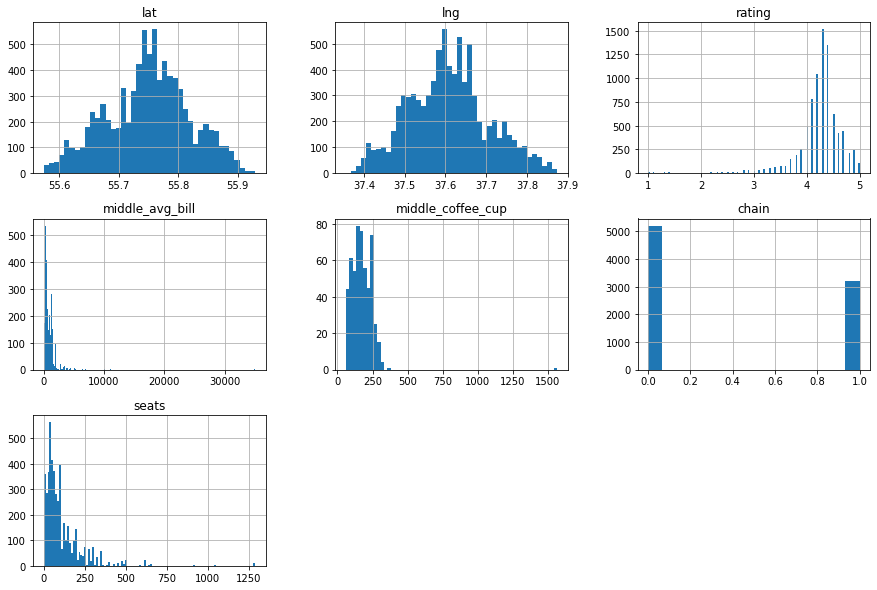

In [5]:
rest_data.hist(figsize=(15, 10), bins='auto');

<a id='prelim_resume'></a>
**Промежуточные выводы:**

- в датасете представлена информация о 8406 заведениях;

- данные в большей часть столбцов имеет тип строки: это касается как очевидных строковых столбцов: название, категория, адрес, район, уровень цен —, так и столбцов, от которых по умолчанию ожидаешь иного типа значения (число или дата/время): часы работы и средний чек. Столбец `chain` имеет целочисленный тип. Остальные столбцы имеют тип `float`. В целом острой необходимости в изменении типов данных нет.

- пропусков довольно много: они есть в столбцах с часами работы, уровнем цен, средними чеками и количеством мест;

- судя по статистическому описанию данных, в столбцах со средним чеком и количеством мест есть немного неожиданные значения — нули. Если для количества мест это ещё хоть как-то объяснимо (take-away restaurants), то для среднего чека это понять сложнее.

- распределения данных в числовых столбцах на первый взгляд достаточно ожидаемые, хотя какие-то небольшие выбросы в столбцах со средним чеком и количеством мест, кажется, имеются.

## Предобработка данных

### Дубликаты

Перед началом предобработки сохраним количество строк в датасете в переменную `rows_number_before`: 

In [6]:
rows_number_before = rest_data.shape[0]

Начнём с простого. Просмотрим список уникальных значений в столбцах с категориями, районами и уровнем цены и поищем неявные дубликаты: 

In [7]:
display(sorted(rest_data['category'].unique()))
display(sorted(rest_data['district'].unique()))
rest_data['price'].unique()

['бар,паб',
 'булочная',
 'быстрое питание',
 'кафе',
 'кофейня',
 'пиццерия',
 'ресторан',
 'столовая']

['Восточный административный округ',
 'Западный административный округ',
 'Северный административный округ',
 'Северо-Восточный административный округ',
 'Северо-Западный административный округ',
 'Центральный административный округ',
 'Юго-Восточный административный округ',
 'Юго-Западный административный округ',
 'Южный административный округ']

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

В столбцах `category`, `district` и `price` дубликатов нет.

Теперь проверим, нет ли у нас дублирующихся наименований заведений. Посчитаем уникальные значения в столбце с названиями:

In [8]:
print('Уникальных названий:', rest_data['name'].nunique())
print('Всего заведений:', len(rest_data))

Уникальных названий: 5614
Всего заведений: 8406


Всего заведений 8604, а уникальных названий 5614. Видимо, дело в сетях — заведения, относящиеся к одной сети, но расположенные в разных местах, приводятся как самостоятельные заведения. Тогда лучше отдельно рассматривать сетевые и несетевые заведения.

Стоит проверить, нет ли сетей с одинаковыми названиями. Нужно привести все названия к нижнему регистру. Убедимся сначала, что это не принесёт большого вреда (на тот случай, если для названий каких-то заведений регистр является единственным отличием от других названий). Выведем список, содержащий в себе названия, которые перестали быть уникальными после приведения их к нижнему регистру:

In [9]:
unique_names_after_lower = [
    name.lower() for name in rest_data['name'].unique()
]

values, counts = np.unique(unique_names_after_lower, return_counts=True)

pd.DataFrame({'name': values, 'cnt': counts})\
    .query('cnt > 1')['name']\
    .values

array(['abc coffee roasters', 'bb grill', 'bfl’s', 'burger club',
       'carrots and beans', 'coffee point', 'deli2go', 'di villaggio',
       'espresso bar', 'flip', 'han cook', 'hellopapaya', 'i like wine',
       'il pizzaiolo', 'istanbul kebab', 'korean chick',
       'ku: рамен изакая бар', 'more poke', 'noba coffee',
       'nova bubble tea', 'one price coffee', 'one&double',
       'pasta cup & pizza', 'pho street', 'pinzeria by bontempi',
       'poke house', 'pomodoro royal', 'raw to go', 'sedelice',
       'sova coffee', 'star hit cafe', 'the wild bean cafe', 'vabene',
       'wave california poke', 'wild bean cafe', 'авлабар', 'ача-чача',
       'бишкек сити', 'важная персона', 'вкус востока', 'вкус дня',
       'вкусвилл, кафе', 'вьет лотос', 'гастроферма', 'греки здесь',
       'гриль хаус', 'гюмри хауз', 'даблби', 'домик в саду',
       "домино'с пицца", 'донер & гриль', 'донер бистро', 'донер кебаб',
       'донер хаус', 'ели сацебели', 'здоровое питание', 'как дома',
 

Кажется, большого вреда от перехода к нижнему регистру не будет. Названия, переставшие быть уникальными, в в основном достаточно оригинальные, поэтому вряд ли при их переводе в нижний регистр они будут приписаны к другим сетям. Наоборот, переводя такие названия в нижний регистр мы снижаем количество дубликатов. Сделаем это:

In [10]:
rest_data['name'] = rest_data['name'].str.lower()

Теперь будем вручную искать дубликаты в названиях сетей. Для простоты поиска транслитерируем названия при помощи модуля `iuliia` ([подробнее о модуле](https://habr.com/ru/post/499574/)). Для всех значений, которые мы определим как подозрительные, проведём дополнительную проверку (выполнялось в скрэтч-пэде и не была включена в эту тетрадку из соображений экономии места).

In [11]:
translit_names = []

for name in rest_data.query('chain == 1')['name'].unique():
    translit_names.append(iuliia.translate(name, schema=iuliia.ICAO_DOC_9303))

sorted(translit_names)

['1-ia krevetochnaia',
 '10 idealnykh pitsts',
 '18 gramm',
 '4 sezona',
 '7 sendvichei',
 '8 vafel',
 '9 bar coffee',
 'abc coffee roasters',
 'acha-chacha',
 'air coffee',
 'aiva',
 'akademiia',
 'alenka',
 'allo! pitstsa',
 'americano black coffee & food',
 'anderson',
 'andiamo',
 'antonio',
 'apelsin',
 'arabix',
 'arame',
 'ararat',
 'arcus bar and food',
 'asia gourmet',
 'avokado',
 'avtospastudiia',
 'azbuka daily',
 'azerbaidzhan',
 'bakery',
 'bakinskii dvorik',
 'baku',
 'bambl kofe',
 'bar-restoran territoriia',
 'barakat',
 'barbaris',
 'barbarista',
 'batoni',
 'bazilik',
 'bb&burgers',
 'berger steik',
 'besedka',
 'bfl’s',
 'biblioteka shisha lounge',
 'bigsushi',
 'bishkek',
 'bistro 24',
 'biuro pitstsy',
 'biznes-kafe',
 'black star burger',
 'blinberi',
 'blinnaia',
 'bobry i utki',
 'bodrero',
 'bon lavash',
 'boston seafood & bar',
 'bota',
 'bowl family',
 'branch',
 'brasserie lambic',
 'bro&n',
 'brooms',
 'brusnika',
 'bukhanka',
 'bulbianaia',
 'bulka',
 'bu

«Подозрительные» значения:

- чайхана 24 (чайхана-24)

- чайхона №1 (чайхона № 1)

- караван (karavan)

- кафе (кафе-бар)

- китчен (kitchen)

- лес (les) 

- мое кафе (моё кафе)

- pho bo (phobo) 

- зефир (zeфир)

- white fox (white fox cafe)

- wild bean (wild bean cafe)

- яндекс лавка (яндекс.лавка)

Названия, отличающиеся друг от друга только по наличию / отсутствию видового названия считались нами одинаковыми, если они сопровождались относительно редким именем собственным (White Fox и White Fox Cafe), или различающимися, если имя собственное было неоригинальным (кафе и кафе-бар).

Из них по результатам проверки по дополнительным признакам (категория, адрес, средний чек, время работы) дубликатами признаны:

- чайхана 24 (чайхана-24)

- чайхона №1 (чайхона № 1)

- мое кафе (моё кафе)

- white fox (white fox cafe)

- wild bean (wild bean cafe)

- яндекс лавка (яндекс.лавка)

Каждую пару приведём к тому названию, которое написано без скобок. Для контроля выведем количество строк, в которых сохранился прежний вариант названия:

In [12]:
names_to_change = [('чайхана-24', 'чайхана 24'), ('чайхона № 1', 'чайхона №1'),
                   ('моё кафе', 'мое кафе'), ('white fox cafe', 'white fox'),
                   ('wild bean cafe', 'wild bean'),
                   ('яндекс.лавка', 'яндекс лавка')]

for name in names_to_change:
    rest_data.loc[rest_data['name'] == name[0], 'name'] = name[1]

len(rest_data[rest_data['name'].isin([name[0] for name in names_to_change])])

0

Дубликаты в названиях сетей ликвидированы. Перейдём теперь к несетевым заведениям. Их отсмотреть так же подробно не удастся — слишком много названий. Поэтому пойдём другим путём.

Исключим заведения, которые относятся к сетям, и посмотрим уникальные названия: 

In [13]:
print('Уникальных названий:', rest_data.query('chain == 0')['name'].nunique())
print('Всего заведений (без сетевых):', len(rest_data.query('chain == 0')))

Уникальных названий: 4803
Всего заведений (без сетевых): 5201


Получается, около 400 названий заведений повторяются, но при этом они не являются сетевыми. Это странно. Посмотрим, что это за заведения:

In [14]:
multiple_rests_not_chains = pd.DataFrame(rest_data.query('chain == 0')['name']
                                         .value_counts())\
    .query('name > 1')

with pd.option_context('display.max_rows', 100):
    display(multiple_rests_not_chains)

,name
кафе,189
шаурма,43
ресторан,34
столовая,28
кофейня,12
бистро,12
кафе-столовая,9
буфет,8
трапезная,7
шашлычная,6


<a id='general_names'></a>
Основная масса таких заведений названы просто групповыми названиями. Они не имеют какого-либо собственного названия. После того, как мы разберёмся с настоящими дубликатами, эти названия можно будет превратить в уникальные, чтобы не потерять данные.

Что касается остальных заведений, то они похожи на маленькие сети. Для наших целей можно их считать таковыми: присвоим (вернём) этим мини-сетям статус сетей. Отметим, что все такие мини-сети имеют менее 3 заведений. Это поможет нам определить, каким именно наименованиям следует присвоить статус сети.

In [15]:
rest_data.loc[
    rest_data['name'].isin(multiple_rests_not_chains.query('name < 3').index),
    'chain'] = 1

Теперь на основании координат попробуем определить, какие заведения, в том числе сетевые, являются дубликатами. Мы рассматриваем здесь именно координаты, а не адреса, потому что при совпадающих координатах заведения со схожими названиями явно будут дубликатами. Адрес не даёт такой 100-процентной уверенности, поскольку по одному адресу теоретически может быть несколько одинаковых названий (в большом торговом центре может быть несколько шавермичных).

In [16]:
same_coordinates_rests = (rest_data.groupby(['lat', 'lng']).agg({
    'name': ['count', 'first', 'last']
}).droplevel(0, axis=1).query('count > 1').sort_values(by='count',
                                                       ascending=False))

same_coordinates_rests

,,count,first,last
lat,lng,,,
55.706883,37.592096,3,франклинс бургер,laserland кафе
55.670021,37.552480,3,кофе,суши мания
55.607489,37.532367,2,кофешефф,крошка картошка
55.805361,37.708967,2,прошу к столу,хинкальная
55.761690,37.658536,2,стейк & бургер,soul in the bowl
55.762784,37.594602,2,ava,patriki
55.780218,37.593084,2,бансонс бургер китчен,лепим и варим
55.782729,37.513952,2,кафе-кулинария сикварули,сикварули
55.788610,37.783970,2,чайхана doner кафе,чайхана döner


Посмотрим, какие заведения оказались по одним координатам в количестве 3 штук:

In [17]:
display(
    rest_data.query('lat == 55.706883 and lng == 37.592096')[[
        'lat', 'lng', 'name'
    ]])
rest_data.query('lat == 55.670021 and lng == 37.552480')[[
    'lat', 'lng', 'name'
]]

,lat,lng,name
6087,55.706883,37.592096,франклинс бургер
6097,55.706883,37.592096,креветочная
6226,55.706883,37.592096,laserland кафе


,lat,lng,name
7066,55.670021,37.55248,кофе
7076,55.670021,37.55248,южная ночь
8401,55.670021,37.55248,суши мания


Явно видны несколько неявных дубликатов (утверждать это с уверенностью нам позволяет подозрительное сходство названий и одинаковые координаты):

- сикварули (кафе-кулинария сикварули),
- чайхана döner (чайхана doner кафе),
- more poke,
- dragon bubble tea (dragon mixology bar),
- кафе (халяль кафе-пекарня), 
- leon (леон)

Эти дубликаты возникли, возможно, при внесении одного и того же заведения под несколько разными названиями по ошибке.

В тех случаях, когда по одним координатам расположены три заведения, дубликатов не видно.

Пожалуй, одно заведение из каждой пары стоит удалить. Будем удалять те, по которым меньше информации. Для этого сначала выведем строки по каждому заведению:

In [18]:
rest_names_to_filter = [
    'кафе-кулинария сикварули', 'сикварули', 'чайхана doner кафе',
    'чайхана döner', 'more poke', 'more poke', 'dragon bubble tea',
    'dragon mixology bar', 'кафе', 'халяль кафе-пекарня', 'leon', 'леон'
]

rows_to_display = []
flag = 0

for name in rest_names_to_filter:
    coords = same_coordinates_rests.query(
        'first == @name or last == @name').index[0]
    if name == 'more poke':
        if flag == 0:
            rows_to_display.append(
                rest_data.query(
                    'name == @name and lat == @coords[0] and lng == @coords[1]'
                ).index[0])
            flag = 1
        else:
            rows_to_display.append(
                rest_data.query(
                    'name == @name and lat == @coords[0] and lng == @coords[1]'
                ).index[1])
    else:
        rows_to_display.append(
            rest_data.query(
                'name == @name and lat == @coords[0] and lng == @coords[1]').
            index[0])

rest_data.loc[rows_to_display, :]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1324,кафе-кулинария сикварули,ресторан,"Москва, улица Куусинена, 11, корп. 2",Северный административный округ,"ежедневно, 10:00–22:00",55.782729,37.513952,4.4,NaN,NaN,NaN,NaN,0,10.0
1452,сикварули,ресторан,"Москва, улица Куусинена, 11, корп. 2",Северный административный округ,"ежедневно, 10:00–22:00",55.782729,37.513952,4.4,NaN,NaN,NaN,NaN,1,10.0
2697,чайхана doner кафе,кафе,"Москва, Измайловский проспект, 61, стр. 2",Восточный административный округ,"ежедневно, круглосуточно",55.788610,37.783970,4.0,NaN,NaN,NaN,NaN,0,15.0
2841,чайхана döner,кафе,"Москва, Измайловский проспект, 61с2",Восточный административный округ,"ежедневно, круглосуточно",55.788610,37.783970,4.0,NaN,NaN,NaN,NaN,0,NaN
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2719,dragon bubble tea,кафе,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.810949,37.799413,4.0,NaN,NaN,NaN,NaN,0,NaN
2866,dragon mixology bar,кафе,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"ежедневно, 10:00–22:00",55.810949,37.799413,3.8,NaN,NaN,NaN,NaN,0,NaN
1071,кафе,быстрое питание,"Москва, Анадырский проезд, 8, корп. 1",Северо-Восточный административный округ,NaN,55.863555,37.682835,3.7,NaN,NaN,NaN,NaN,0,100.0
1074,халяль кафе-пекарня,булочная,"Москва, Анадырский проезд, 8, корп. 1",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.863555,37.682835,3.7,NaN,Средний счёт:300–700 ₽,500.0,NaN,0,100.0


Удалим следующие наименования: кафе-кулинария сикварули, чайхана döner, more poke (1430), dragon bubble tea, кафе, леон.

In [19]:
rest_data.drop(labels=[1324, 2841, 2719, 1430, 1071, 5316],
               axis=0,
               inplace=True)

rest_data.reset_index(drop=True, inplace=True)

Как мы и [собирались](#general_names), превратим некоторые групповые названия в уникальные.

In [20]:
general_names = multiple_rests_not_chains.query('name > 2').index


def make_name_unique(row):
    if row['name'] in general_names:
        return row['name'] + '_' + str(row['index'])
    return row['name']


rest_data['name'] = rest_data.reset_index().apply(axis=1,
                                                  func=make_name_unique)

Теперь рассмотрим более общую ситуацию, когда заведения с совершенно одинаковым названием оказываются по одному адресу. Здесь не будет такой же однозначности, как в случае с одинаковыми координатами.

In [21]:
rest_data.groupby(['name', 'address']).agg({'name': 'count'}).query('name > 1')

,,name
name,address,
раковарня клешни и хвосты,"Москва, проспект Мира, 118",2
хлеб да выпечка,"Москва, Ярцевская улица, 19",2


Посмотрим повнимательнее на эти два адреса:

In [22]:
rest_data\
    .query('address == "Москва, проспект Мира, 118" or address == "Москва, Ярцевская улица, 19"')\
    .sort_values(by='name',
                 ascending=False)\
    .head(10)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2237,штолле,булочная,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.811167,37.638411,4.3,NaN,NaN,NaN,NaN,1,150.0
3066,шоколадница,кофейня,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738692,37.410416,4.2,NaN,NaN,NaN,NaN,1,276.0
3119,хлебо mania,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738500,37.410805,4.5,NaN,NaN,NaN,NaN,0,276.0
3104,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0
3086,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0
3007,хачапури,быстрое питание,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 10:00–23:00",55.739318,37.410968,4.6,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,276.0
3087,теремок,ресторан,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738548,37.410411,4.1,средние,Средний счёт:300–400 ₽,350.0,NaN,1,276.0
3027,ресторан-бар zames,"бар,паб","Москва, Ярцевская улица, 19",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.738323,37.409466,4.5,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,0,276.0
2417,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
2208,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0


Судя по тому, что количество мест для всех заведений совпадает, эти два адреса — это фудхоллы. Два одинаковых заведения в одном фудхолле — это странно. Удалим строки 2417 (раковарня — это всё же [ресторан](https://www.tripadvisor.ru/Restaurant_Review-g298484-d19100365-Reviews-Rakovarnya_Kleshni_i_Khvosty-Moscow_Central_Russia.html)) и 3104 (в ней меньше данных).

In [23]:
rest_data.drop(labels=[2417, 3104], axis=0, inplace=True)

rest_data.reset_index(drop=True, inplace=True)

Остались ещё три столбца со строковыми данными, в которых могли закрасться дубликаты: адреса, часы работы, средний чек. Это столбцы, в которых большое количество уникальной информации, и просматривать их целиком будет сложно, а вероятность дубликатов там невысокая. Поэтому мы сделаем сэмплы по 50 случайных значений из каждого столбца. Так мы проверим, есть ли там какие-то закономерные искажения (например, где-то может быть написано слово «улица» целиком, а где-то просто «ул.»).

Начнём с адресов:

In [24]:
rest_data['address'].sample(n=50)

5606                       Москва, Душинская улица, 1/3
2865                   Москва, МКАД, 102-й километр, 20
4656                          Москва, Даев переулок, 20
4184                            Москва, улица Арбат, 32
3005                     Москва, Рублёвское шоссе, 48/1
5948                   Москва, Мосфильмовская улица, 2В
1482    Москва, улица Маршала Тухачевского, 41, корп. 1
1460          Москва, Старопетровский проезд, 1, стр. 2
7938                       Москва, Каширское шоссе, 61Г
7381                     Москва, Алма-Атинская улица, 1
5782                Москва, Можайское шоссе, 4, корп. 1
6551              Москва, Никулинская улица, 8, корп. 3
6278                 Москва, Комсомольский проспект, 28
4800                    Москва, улица Кузнецкий Мост, 7
4367       Москва, Нижний Сусальный переулок, 5, стр. 2
6384                Москва, улица Ленинская Слобода, 19
4950                      Москва, Павелецкая площадь, 3
133                           Москва, улица Леск

Закономерных искажений в столбце адресов не наблюдается, будем считать, что дубликатов там нет.

То же самое для столбца с часами работы: 

In [25]:
rest_data[~rest_data['hours'].isnull()]['hours'].sample(n=50)

4573                             ежедневно, круглосуточно
4913                               ежедневно, 09:30–23:00
1694                               ежедневно, 10:00–22:00
4022                 пн-пт 08:00–23:00; сб,вс 09:00–23:00
2134                               ежедневно, 11:00–23:00
1794                               ежедневно, 10:00–22:00
8286                               ежедневно, 10:00–22:00
8042                 пн-пт 12:00–20:00; сб,вс 12:00–22:00
5793                             ежедневно, круглосуточно
7060                                    пн-пт 08:00–19:00
7540                               ежедневно, 08:00–18:00
2822                 пн-пт 08:00–22:00; сб,вс 10:00–22:00
2796                               ежедневно, 07:00–22:00
6592                               ежедневно, 11:00–23:00
4419                                    пн-пт 11:00–23:00
8044    пн-чт 09:00–22:00; пт 09:00–23:00; сб 10:00–23...
4136                 пн-пт 08:00–22:00; сб,вс 10:00–22:00
6355          

Данные в столбце с часами работы выглядят единообразно. Там проблем быть не должно.

Теперь столбец с ценами:

In [26]:
rest_data[~rest_data['avg_bill'].isnull()]['avg_bill'].sample(n=50)

3843           Средний счёт:150–350 ₽
3434         Средний счёт:1000–1500 ₽
8019    Цена чашки капучино:130–170 ₽
4810         Средний счёт:1000–1500 ₽
4748         Средний счёт:1000–1500 ₽
8033       Цена бокала пива:390–530 ₽
5627               Средний счёт:350 ₽
5677         Средний счёт:1000–1500 ₽
6935     Цена чашки капучино:90–100 ₽
2775           Средний счёт:300–500 ₽
2591          Средний счёт:700–1200 ₽
4247           Средний счёт:600–800 ₽
5779           Средний счёт:400–600 ₽
6006              Средний счёт:2000 ₽
6927            Средний счёт:50–250 ₽
5067          Средний счёт:700–1000 ₽
4142         Средний счёт:1000–1300 ₽
4054         Средний счёт:1500–2500 ₽
2094          Средний счёт:600–1000 ₽
4820           Средний счёт:350–400 ₽
4916          Средний счёт:600–1500 ₽
124             Средний счёт:от 200 ₽
4866              Средний счёт:1300 ₽
2696               Средний счёт:422 ₽
2480            Средний счёт:от 500 ₽
6042           Средний счёт:200–350 ₽
3539        

Данные в столбце `avg_bill` тоже выглядят единообразно. Дубликатов быть не должно.

Наконец, проверим таблицу на наличие полных дубликатов:

In [27]:
rest_data.duplicated().sum()

0

Полных дубликатов нет. На этом мы завершаем обработку дубликатов.

### Пропуски

Как уже [отмечалось](#prelim_resume), пропуски есть в столбцах `hours`, `price`, `avg_bill`, `middle_avg_bill`, `middle_coffee_cup` и `seats`.

Посмотрим, как пропуски распределены по столбцам:

In [28]:
omissions = (pd.DataFrame(rest_data.isna().mean(), columns=['omissed_%']))

omissions['omissed_cnt'] = rest_data.isna().sum()

omissions.sort_values(by='omissed_%', ascending=False).style.format({
    'omissed_%':
    '{:.2%}'
}).background_gradient('coolwarm')

,omissed_%,omissed_cnt
middle_coffee_cup,93.63%,7863
middle_avg_bill,62.50%,5249
price,60.53%,5083
avg_bill,54.56%,4582
seats,42.96%,3608
hours,6.36%,534
name,0.00%,0
category,0.00%,0
address,0.00%,0
district,0.00%,0


Больше всего пропусков в столбцах `middle_coffee_cup` и `middle_avg_bill`. Это неудивительно — из условий проекта известно, что эти столбцы заполняются только в том случае, если в столбце `avg_bill` представлено соответствующее значение.

Другие столбцы, где немало пропусков: уровень цен, средняя стоимость заказа, количество мест и часы работы.

Проверим, как связаны пропуски между собой:

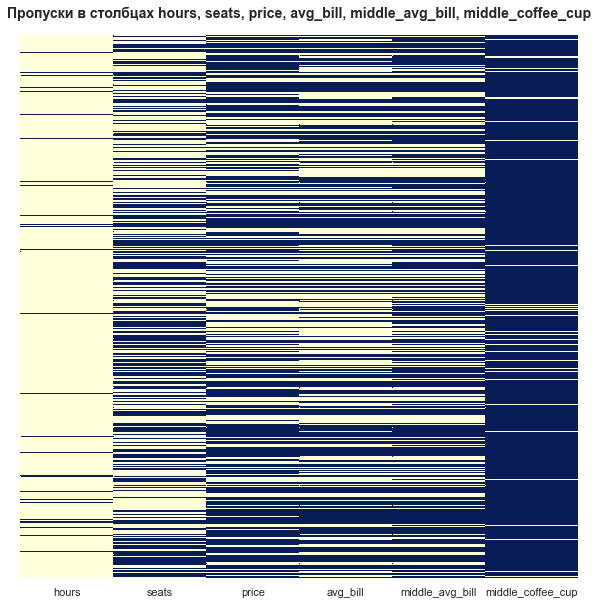

In [29]:
sns.set(rc={'figure.figsize': (10, 10)})
sns.heatmap(rest_data[[
    'hours', 'seats', 'price', 'avg_bill', 'middle_avg_bill',
    'middle_coffee_cup'
]].isna(),
            yticklabels=False,
            cbar=False,
            cmap='YlGnBu')
plt.title(
    'Пропуски в столбцах hours, seats, price, avg_bill, middle_avg_bill, middle_coffee_cup',
    fontsize=14,
    y=1.02,
    fontweight='bold');

Кроме уже отмеченной выше связи между пропусками в столбцах `avg_bill`, `middle_avg_bill` и `middle_coffee_cup`, можно обратить внимание на то, что часто отстутствие данных о средней стоимости заказа приводит к пропуску в столбце `price`. Других взаимосвязей между пропусками обнаружить не удаётся.

Что делать с пропусками?

В столбцах `avg_bill`, `middle_avg_bill` и `middle_coffee_cup` придётся оставить всё как есть. Здесь заполнение каким-нибудь медианным значением или заглушкой не представляется возможным — слишком много пропусков и слишком разнообразные и специфические данные. Заполнение в данном случае приведёт к большому искажению данных.

В столбце `price` мы заполним пропуски в тех случаях, когда есть данные о среднем чеке или среднем кофе. Сделаем мы это [позже](#eliminate_nan_price), когда будем работать с артефактами. 

В столбце `seats` пропуски можно было бы заполнить медианными значениями в зависимости от категории заведения, поскольку дисперсия здесь относительно невелика. Однако это может исказить результаты анализы. По этой причине мы не будем ничем заполнять пропуски в этом столбце.

Пропусков в столбце `hours` относительно немного — всего 6,3% от всего объёма. По этой причине их удаление не приведёт к искажению и только улучшит качество данных. Сделаем это:

In [30]:
rest_data.dropna(subset=['hours'], inplace=True)
rest_data['hours'].isnull().sum()

0

Пропуски в столбце `hours` успешно удалены. На этом обработка пропусков завершена.

### Артефакты и выбросы

Начнём с числовых столбцовых. Посмотрим ещё раз на статистическое описание данных:

In [31]:
rest_data.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,7864.000000,7864.000000,7864.000000,3143.000000,534.000000,7864.000000,4492.000000
mean,55.750723,37.607987,4.244189,957.886096,174.514981,0.405010,107.840383
std,0.068774,0.096773,0.453112,1010.508023,88.906040,0.490925,119.225563
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.706875,37.539841,4.100000,375.000000,124.250000,0.000000,40.000000
50%,55.754163,37.604880,4.300000,750.000000,168.000000,0.000000,75.000000
75%,55.794426,37.662791,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


Вопросы вызывают следующие столбцы:

- `middle_avg_bill`: минимальное значение 0 — это странно, плюс стоит проверить выбросы в сторону максимума.

- `middle_coffee_cup`: 1568 рублей за один стакан капучино — это как будто бы много, надо проверить, много ли таких случаев.

- `seats` — стоит взглянуть, у каких заведений 0 посадочных мест и у каких их 1288.

Данные в столбцах `rating` и `chain` выглядят нормально.

С широтой и долготой мы будем разбираться [отдельно](#map).

Построим диаграмму «ящик с усами» с распределением значений в `middle_avg_bill`. Для этого напишем фукнцию (в дальнейшем нам придётся проделать те же действия для других столбцов):

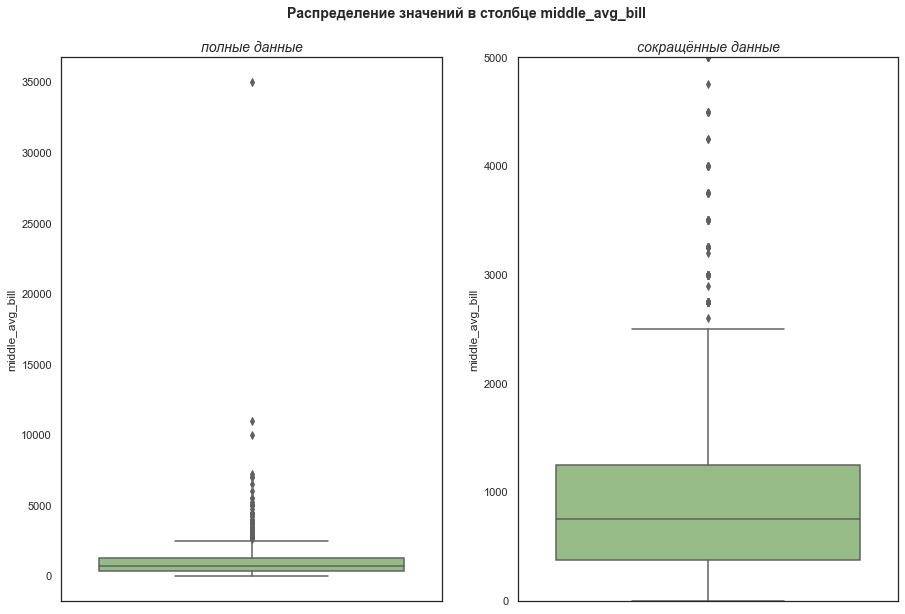

In [32]:
sns.set_style('white')
sns.color_palette("crest", as_cmap=True)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(15, 10))

sns.boxplot(y='middle_avg_bill', data=rest_data, ax=ax1, color='#93c47d')

ax2.set_ylim(0, 5000)
sns.boxplot(y='middle_avg_bill', data=rest_data, ax=ax2, color='#93c47d')

ax1.set_title('полные данные', fontsize=14, style='italic')
ax2.set_title('сокращённые данные', fontsize=14, style='italic')
plt.suptitle('Распределение значений в столбце middle_avg_bill',
             fontsize=14,
             weight='bold',
             y=0.95);

Значений, выходящих за 1,5 межквартильных размаха (в районе 2500 рублей), сравнительно немного. Скорее всего, это какие-то дорогие заведения с высоким рейтингом. Проверим это.

In [33]:
print('Заведений со средним чеком более 2500 рублей:',
      rest_data.query('middle_avg_bill > 2500').shape[0])
rest_data.query('middle_avg_bill > 2500').head(20)

Заведений со средним чеком более 2500 рублей: 104


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
293,parkhouse,ресторан,"Москва, Ленинградское шоссе, 57, корп. 2",Северный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.854905,37.466033,4.5,высокие,Средний счёт:2500–3000 ₽,2750.0,NaN,0,96.0
317,vоdный,ресторан,"Москва, Ленинградское шоссе, 39, стр. 6",Северный административный округ,"ежедневно, 12:00–00:00",55.834978,37.479791,4.7,высокие,Средний счёт:4500–5500 ₽,5000.0,NaN,0,286.0
354,стар самарканд,ресторан,"Москва, Ленинградское шоссе, 84, стр. 1",Северный административный округ,"ежедневно, 07:00–02:00",55.848269,37.475768,4.4,высокие,Средний счёт:1500–5000 ₽,3250.0,NaN,0,84.0
730,чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,0,49.0
754,золотая роща,ресторан,"Москва, улица Бестужевых, 14, корп. 1",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.871153,37.609928,4.3,высокие,Средний счёт:3500–4000 ₽,3750.0,NaN,0,300.0
910,оттепель,ресторан,"Москва, проспект Мира, 119, стр. 311",Северо-Восточный административный округ,пн-ср 11:00–22:00; чт-сб 11:00–23:00; вс 11:00...,55.831359,37.618906,4.7,высокие,Средний счёт:2500–3000 ₽,2750.0,NaN,0,NaN
1033,kle_do cafe,ресторан,"Москва, улица Бажова, 8",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.832750,37.662028,4.2,высокие,Средний счёт:3000 ₽,3000.0,NaN,0,NaN
1124,на мангале,кафе,"Москва, проспект Мира, 119, стр. 503",Северо-Восточный административный округ,"ежедневно, 10:00–21:00",55.830405,37.617687,1.0,высокие,Средний счёт:4000–5000 ₽,4500.0,NaN,0,NaN
1244,песок,кафе,"Москва, 4-я линия Хорошёвского Серебряного Бор...",Северо-Западный административный округ,"ежедневно, 09:00–21:00",55.777716,37.406724,4.3,NaN,Средний счёт:2900 ₽,2900.0,NaN,0,NaN
1429,il barolo,ресторан,"Москва, Ленинградский проспект, 63",Северный административный округ,"ежедневно, 09:30–23:00",55.802775,37.519925,4.2,высокие,Средний счёт:3500–5000 ₽,4250.0,NaN,0,90.0


В целом, наша версия похожа на правду. Можем удалить эти значения, чтобы они не искажали общую картину.

In [34]:
rest_data.drop(labels=rest_data.query('middle_avg_bill > 2500').index,
               axis=0,
               inplace=True)
rest_data.reset_index(drop=True, inplace=True)

Заведения с чересчур большими средними чеками удалены.

Разберёмся с нулевым средним чеком. Как мы видели [ранее](#prelim_resume), в столбце `middle_avg_bill` минимальное значение — это 0. Проверим, часто ли оно там встречается:

In [35]:
rest_data.query('middle_avg_bill == 0').shape[0]

1

0 в качестве суммы чека встречается лишь однократно. Посмотрим на содержающую ноль строку:

In [36]:
rest_data.query('middle_avg_bill == 0')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3404,кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,NaN,1,200.0


Странная строка — уровень цен высокий, при этом средний чек от 0 рублей. Видимо, кто-то ошибся при вводе данных. Это строку можно просто удалить.

In [37]:
rest_data.drop(labels=rest_data.query('middle_avg_bill == 0').index,
               axis=0,
               inplace=True)

rest_data.reset_index(drop=True, inplace=True)

Посмотрим, каково минимальное значение в столбце `middle_avg_bill` теперь:

In [38]:
rest_data['middle_avg_bill'].min()

30.0

Мало, конечно, но гипотетически возможно для какой-нибудь дешёвой пекарни.

Теперь построим диаграмму «ящик с усами» для столбца `middle_coffee_cup`:

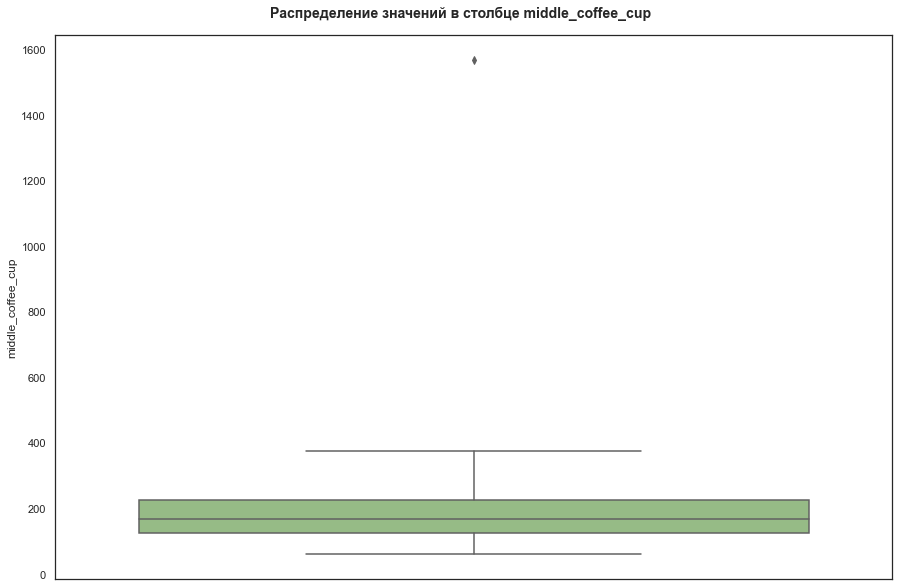

In [39]:
plt.figure(figsize=(15, 10))

sns.boxplot(y='middle_coffee_cup', data=rest_data, color='#93c47d')
plt.suptitle('Распределение значений в столбце middle_coffee_cup',
             fontsize=14,
             weight='bold',
             y=0.92);

Только одно значение выбивается из 1,5 межквартильных размахов — это 1568 рублей. Это явно выброс. Удалим его. 

In [40]:
rest_data.drop(labels=rest_data.query('middle_coffee_cup > 400').index,
               axis=0,
               inplace=True)
rest_data.reset_index(drop=True, inplace=True)

Теперь построим «ящик с усами» для столбца `seats`:

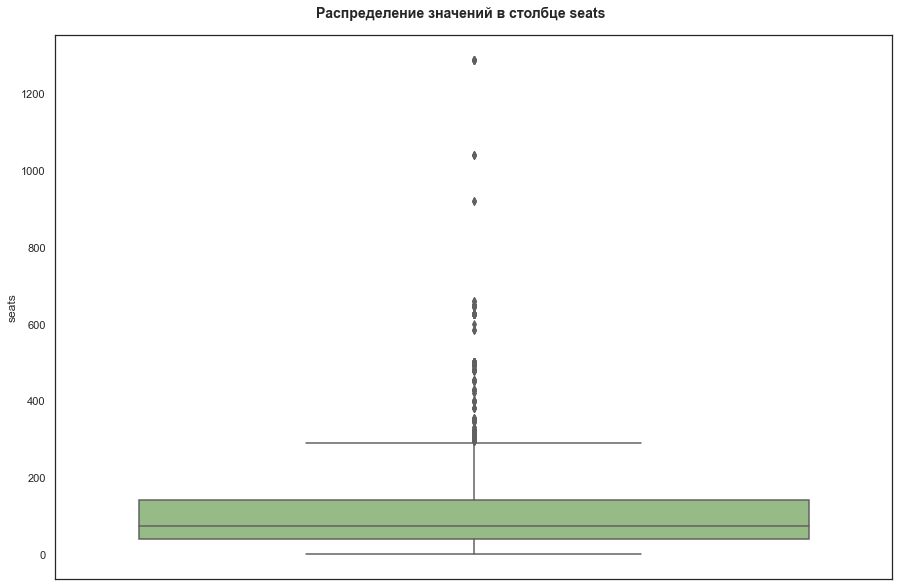

In [41]:
plt.figure(figsize=(15, 10))

sns.boxplot(y='seats', data=rest_data, color='#93c47d')
plt.suptitle('Распределение значений в столбце seats',
             fontsize=14,
             weight='bold',
             y=0.92);

Здесь тоже за пределами 1,5 межквартильных размахов оказывается не так много значений. Возможно, больше 300 мест — это какие-то фудхоллы. Проверим нашу гипотезу:

In [42]:
rest_data.query('seats > 300').sort_values(by='seats').head(15)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7671,чайхана бишкек,ресторан,"Москва, Тихорецкий бульвар, 2, корп. 1",Юго-Восточный административный округ,"ежедневно, 09:00–01:30",55.679190,37.776553,4.1,NaN,NaN,NaN,NaN,0,305.0
4780,козловица,"бар,паб","Москва, Пятницкая улица, 29",Центральный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.740832,37.629231,4.4,средние,Средний счёт:800–1200 ₽,1000.0,NaN,0,306.0
4863,правда кофе,кофейня,"Москва, Пятницкая улица, 29",Центральный административный округ,"пн-пт 07:30–22:00; сб,вс 09:00–22:00",55.740840,37.629004,4.3,низкие,Средний счёт:90–190 ₽,140.0,NaN,1,306.0
4840,prime,ресторан,"Москва, Пятницкая улица, 29",Центральный административный округ,пн-пт 07:00–22:00; сб 08:00–22:00; вс 08:00–21:00,55.740840,37.629040,4.2,средние,Средний счёт:400 ₽,400.0,NaN,1,306.0
4767,french bakery,кафе,"Москва, Пятницкая улица, 29",Центральный административный округ,пн-пт 07:30–23:00; сб 08:00–22:00; вс 09:00–21:00,55.740980,37.628645,4.4,NaN,NaN,NaN,NaN,1,306.0
4636,мару,быстрое питание,"Москва, Пятницкая улица, 29",Центральный административный округ,"ежедневно, 11:00–22:45",55.740827,37.629363,4.2,NaN,NaN,NaN,NaN,0,306.0
4742,o'donoghue's pub,"бар,паб","Москва, Пятницкая улица, 29",Центральный административный округ,пн-чт 12:00–00:00; пт 12:00–06:00; сб 12:00–03...,55.740836,37.629165,4.5,выше среднего,Цена бокала пива:155–465 ₽,NaN,NaN,0,306.0
4650,mañana,"бар,паб","Москва, Пятницкая улица, 29",Центральный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–03:00; вс 12:00...",55.740838,37.629087,4.7,высокие,Цена бокала пива:до 350 ₽,NaN,NaN,0,306.0
4661,джонджоли,ресторан,"Москва, Пятницкая улица, 29",Центральный административный округ,"ежедневно, 11:00–00:00",55.741036,37.628652,4.4,средние,Средний счёт:700–1300 ₽,1000.0,NaN,1,306.0
1639,батони,ресторан,"Москва, Новослободская улица, 18",Центральный административный округ,"ежедневно, 11:30–00:00",55.782256,37.599340,4.3,NaN,NaN,NaN,NaN,1,307.0


Наша гипотеза подтверждается по крайней мере отчасти. Судя по количеству заведений по одному адресу, некоторые из них действительно находятся в фудхоллах (а в фудхоллах бывает и больше 1000 посадочных мест). Но насчёт других ничего определённого сказать нельзя без более глубокого анализа, который сейчас кажется излишним.

Поскольку здесь есть фудхоллы, не будем удалять эти строки из таблицы. В фудхоллах могут располагаться любые типы заведений, так что большого искажения из-за них возникать не должно.

Теперь разберёмся с заведениями, в которых 0 мест. Не каждая категория заведений может позволить себе такую роскошь. Проверим, как распределены заведения с 0 мест по категориям: 

In [43]:
(rest_data.query('seats == 0').groupby('category').agg({
    'seats': 'count'
}).sort_values(by='seats', ascending=False))

,seats
category,
кафе,37
кофейня,24
ресторан,18
быстрое питание,17
булочная,11
пиццерия,10
столовая,5
"бар,паб",4


В принципе кафе, кофейня, заведение быстрого питания, булочная и пиццерия могут работать только на вынос. А вот представить себе столовую, ресторан и бар, не предоставляющие возможности посидеть, нельзя. Поэтому такие заведения надо удалить:


In [44]:
categories_to_clean = ['ресторан', 'пиццерия', 'бар,паб']

rest_data.drop(labels=rest_data.query(
    'seats == 0 and category in @categories_to_clean').index,
               axis=0,
               inplace=True)

rest_data.reset_index(drop=True, inplace=True)

<a id='map'></a>
Посмотрим теперь, все ли заведения, представленные в датасете, находятся в Москве:

In [45]:
moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)


def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']}",
    ).add_to(marker_cluster)


rest_data.apply(create_clusters, axis=1)
title_html = '''
             <h4 align="center" style="font-size:20px"><b>География заведений в датасете</b></h4>
             '''
m.get_root().html.add_child(Element(title_html))

m

Все заведения находятся в Москве, как и говорилось в условии проекта. На всякий случай проверим, все ли адреса имеют указание на Москву.

In [46]:
rest_data.apply(lambda x: re.search('Москва', x['address']) is None,
                axis=1).sum()

0

Во всех адресах фигурирует Москва.

Мы ещё не рассмотрели артефакты в столбцах с названиями, категориями, районами, часами и средней стоимостью заказа.

Однако все эти столбцы рассматривались достаточно подробно в разделе обработки пропусков, поэтому отдельно их рассматривать в рамках нашего исследования смысла нет. Там артефактов быть не должно.

Проверим ещё несколько мелких моментов.

Выясним, каким типам заведений соответствует наличие значения в столбце `middle_coffee_cup`:

In [47]:
rest_data.loc[~rest_data['middle_coffee_cup'].isnull(), 'category'].unique()

array(['кофейня', 'кафе', 'бар,паб', 'быстрое питание', 'пиццерия'],
      dtype=object)

Странно, что для бара, заведения быстрого питания и пиццерии в качестве определяющего показателя выбрана цена за кофе. Проверим, что это за бары-фастфуды-пиццерии такие:

In [48]:
suspicious_categories = ['бар,паб', 'быстрое питание', 'пиццерия']

rest_data.loc[((~rest_data['middle_coffee_cup'].isnull()) &
               (rest_data['category'].isin(suspicious_categories))), :]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2836,кофеварка,"бар,паб","Москва, Крылатская улица, 31к2",Западный административный округ,"пн-пт 09:00–21:00; сб,вс 10:00–21:00",55.770008,37.409037,4.2,средние,Цена чашки капучино:150–200 ₽,NaN,175.0,0,NaN
3270,bo-bo lounge,"бар,паб","Москва, Большая Садовая улица, 5, корп. 1",Центральный административный округ,"ежедневно, 15:00–05:00",55.768362,37.592630,4.6,высокие,Цена чашки капучино:от 250 ₽,NaN,250.0,0,98.0
3305,румбокс,"бар,паб","Москва, Новинский бульвар, 22",Центральный административный округ,"ежедневно, 07:30–22:00",55.756698,37.584777,4.3,средние,Цена чашки капучино:180–210 ₽,NaN,195.0,0,NaN
3809,fine coffee bar,"бар,паб","Москва, улица Волхонка, 9, стр. 2",Центральный административный округ,"пн-пт 09:00–23:00; сб,вс 10:00–23:00",55.747145,37.607987,4.4,средние,Цена чашки капучино:250 ₽,NaN,250.0,0,NaN
4512,coffeebara,"бар,паб","Москва, Таганская улица, 32/1с1",Центральный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–20:00",55.739432,37.665045,4.3,средние,Цена чашки капучино:130–210 ₽,NaN,170.0,0,NaN
5877,филин,"бар,паб","Москва, Автозаводская улица, 13/1",Южный административный округ,"пн-пт 09:00–23:00; сб,вс 10:00–22:00",55.705543,37.655954,4.3,средние,Цена чашки капучино:170–250 ₽,NaN,210.0,1,15.0
6014,кофе с собой,быстрое питание,"Москва, Волгоградский проспект, 45",Юго-Восточный административный округ,пн-пт 08:00–18:00,55.713091,37.720798,4.2,NaN,Цена чашки капучино:100–180 ₽,NaN,140.0,1,NaN
6461,профессор пуф,пиццерия,"Москва, Новочерёмушкинская улица, 53А",Юго-Западный административный округ,"ежедневно, 08:00–20:00",55.671831,37.569531,4.2,средние,Цена чашки капучино:от 160 ₽,NaN,160.0,1,NaN


Судя по всему, мы наблюдаем ошибку в категоризации заведений. Приведённые заведения, скорее всего, относятся к другим категориям на самом деле. Удалим их из таблицы во избежание искажений.

In [49]:
rest_data.drop(labels=rest_data.loc[(
    (~rest_data['middle_coffee_cup'].isnull())
    & (rest_data['category'].isin(suspicious_categories))), :].index,
               axis=0,
               inplace=True)

rest_data.reset_index(drop=True, inplace=True)

Проверять обратную ситуацию, когда у кофеен есть значение в столбце `middle_avg_bill`, а столбец `middle_coffee_cup` пустует, мы не будем — это вполне реальная ситуация. Всё-таки кофейня может считать себя кофейней, но больше зарабатывать на десертах. Правда, в анализ такие заведения (а их около 200) мы включать не будем.

Проверим, не пересекаются ли у нас ценовые диапазоны (всегда ли цена однозначно попадает в один ценовой диапазон). Для этого напишем функцию `display_price_ranges` и применим её к столбцу `middle_avg_bill`:

In [50]:
def display_price_ranges(column):
    return (rest_data.groupby('price', as_index=False).agg({
        column: ['max', 'min']
    }).droplevel(0, axis=1).rename(columns={
        'max': 'max_price',
        'min': 'min_price'
    }).sort_values(by='max_price', ascending=False))


display_price_ranges('middle_avg_bill')

,,max_price,min_price
0,высокие,2500.0,950.0
1,выше среднего,2250.0,375.0
3,средние,2150.0,165.0
2,низкие,600.0,90.0


Ценовые диапазоны, если судить по максимумам и минимумам цен, пересекаются очень заметно. Посмотрим, насколько это частое явление, построив диаграмму рассеяния:

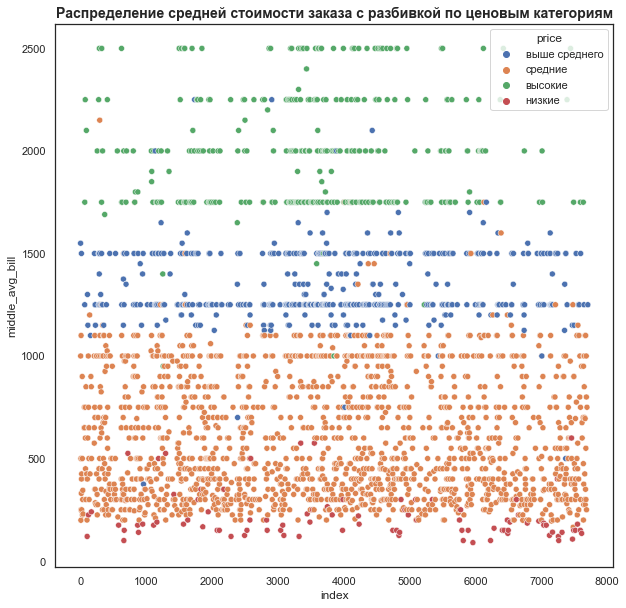

In [51]:
sns.scatterplot(y='middle_avg_bill',
                x='index',
                hue='price',
                data=rest_data.reset_index())
plt.title(
    'Распределение средней стоимости заказа с разбивкой по ценовым категориям',
    fontsize=14,
    weight='bold');

<a id='eliminate_nan_price'></a>
В целом цены достаточно точно группируются по категориям. Отдельные несоответствия немногочисленны (на глаз не более 5%), их можно списать на ошибки ввода данных. Их мы устраним, изменив категорию тех заведений, которые не попали в 95-й перцентиль. Таким образом мы ещё и заполним пропуски в столбце `price` в тех строках, в которых есть данные о среднем чеке. Чтобы не получить пропуски в тех строках, для которых ситуация обратная (есть значение в `price` и нет значения в `middle_avg_bill`), мы напишем и применим функцию `change_to_old`.

Всё это вместе мы упакуем в функцию (процедуру) `rearrange_categories`. Она нам пригодится при работе со столбцом `middle_coffee_cup`.

In [52]:
def rearrange_price_cats(column, price_cats, percentile):

    percentiles = [0]

    for price_cat in price_cats:
        percentiles.append(
            np.percentile(
                rest_data.query('price == @price_cat')[column].dropna(),
                percentile))

    price_cats_old = rest_data['price']

    rest_data['price'] = pd.cut(rest_data[column],
                                sorted(percentiles),
                                labels=price_cats)

    def change_to_old(row):
        if pd.isna(row['price']) and not pd.isna(price_cats_old[row['index']]):
            return price_cats_old[row['index']]
        return row['price']

    rest_data['price'] = rest_data.reset_index().apply(change_to_old, axis=1)


rearrange_price_cats('middle_avg_bill',
                     ['низкие', 'средние', 'выше среднего', 'высокие'], 95)

Посмотрим теперь на ценовые диапазоны:

In [53]:
display_price_ranges('middle_avg_bill')

,,max_price,min_price
0,высокие,2500.0,1600.0
1,выше среднего,1550.0,1125.0
3,средние,1100.0,525.0
2,низкие,510.0,30.0


Стало лучше, теперь ценовые диапазоны по среднему чеку не пересекаются. 

Теперь проверим таким же образом столбец `middle_coffee_cup`:

In [54]:
display_price_ranges('middle_coffee_cup')

,,max_price,min_price
3,средние,328.0,60.0
1,выше среднего,256.0,256.0
2,низкие,256.0,60.0
0,высокие,NaN,NaN


Всё перемешано. Построим диаграмму рассеяния:

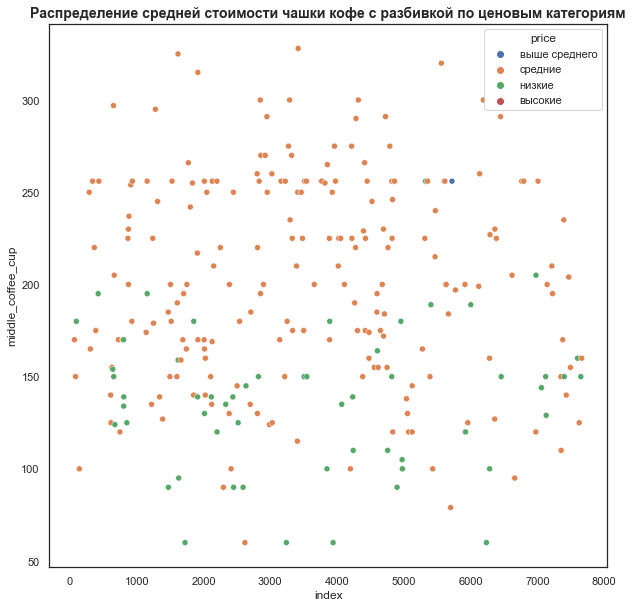

In [55]:
sns.scatterplot(y='middle_coffee_cup',
                x='index',
                hue='price',
                data=rest_data.reset_index())
plt.title(
    'Распределение средней стоимости чашки кофе с разбивкой по ценовым категориям',
    fontsize=14,
    weight='bold');

Данных по стоимости кофе меньше и выглядят они гораздо более хаотично. По сути представлены только две ценовые категории — это низкие и средние цены. Строка с ценами выше среднего всего одна. Цен из категории высоких нет вообще.

Пожалуй, правильным будет разделить все цены на низкие и средние. Границу будем проводить по 90-му перцентилю группы низких цен (уменьшим допуск, поскольку разброс цен здесь гораздо больше).

In [56]:
rearrange_price_cats('middle_coffee_cup', ['низкие', 'средние'], 90)

display_price_ranges('middle_coffee_cup')

,,max_price,min_price
3,средние,328.0,184.0
2,низкие,180.0,60.0
0,высокие,NaN,NaN
1,выше среднего,NaN,NaN


Теперь уровни цен в кофейнях и подобных заведениях соответсвуют средним ценам за чашку кофе.

Посмотрим, существуют ли кофейни, в которых уровень цен — высокий или выше среднего:

In [57]:
rest_data.query('category == "кофейня" and (price == "высокие" or price == "выше среднего")').shape[0]

29

Они существуют, но их немного — всего 29 штук. Оставим их как есть, их наличие на анализ цен не повлияет.

Напоследок проверим, сколько всего строк мы удалили в ходе предобработки:

In [58]:
print(
    f'Удалено {rows_number_before - rest_data.shape[0]} строк ({(rows_number_before - rest_data.shape[0])/rows_number_before:.2%})'
)

Удалено 688 строк (8.18%)


В целом мы не слишком уменьшили размер таблицы, зато серьёзно повысили качество данных в ней.

### Добавление столбцов

Введём дополнительные столбцы, которые понадобятся нам в ходе дальнейшего анализа:

- столбец `street` с названием улицы, на которой находится заведение,

- столбец `is_24/7` со значением `True`, если заведение работает ежедневно и круглосуточно, и `False`, если нет.

In [59]:
rest_data['street'] = rest_data.apply(lambda x: x['address'].split(', ')[1],
                                      axis=1)


def extract_working_schedule(row):
    if row['hours'] == 'ежедневно, круглосуточно':
        return True
    return False


rest_data['is_24/7'] = rest_data.apply(extract_working_schedule, axis=1)

rest_data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,низкие,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,низкие,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


Также добавим столбец `district_short` с коротким названием административных округов:

In [60]:
rest_data['district_short'] = rest_data['district'].map(lambda x: x.split()[0])
rest_data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_short
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False,Северный
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False,Северный
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False,Северный
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,низкие,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False,Северный
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,низкие,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False,Северный


Столбцы успешно добавлены. На этом предобработка данных завершена.

**Краткие итоги:**

- удалены неявные дубликаты в названиях сетей и несетевых заведений, восстановлен сетевой статус для некоторых заведений, некоторые названия приведены к уникальному виду, установлено отстутсвие явных дубликатов;


- удалены пропуски в столбце `hours`, частично заполнены пропуски в столбце `price`;


- удалены выбросы в столбцах `middle_avg_bill` и `middle_coffee_cup`, удалены артефактные строки с несоответствующими количеству мест и типу среднего чека типами заведений, на основе данных о средних чеках и стоимости кофе скорректированы ценовые категории заведений, установлено остутствие артефактов и выбросов в других столбцах, установлено, что все заведения действительно находятся в Москве;


- добавлены столбцы `street`, `is_24/7` и `district_short`.

## Исследовательский анализ данных

### Распределение заведений по категориям и принадлежности к сетям

Посмотрим, как распределены заведения по категориям. Построим круговую диаграмму с долей и количеством заведений каждого типа:

In [61]:
rests_by_category = pd.DataFrame(rest_data['category'].value_counts())\
    .reset_index()\
    .rename(columns={
    'index': 'category',
    'category': 'rest_cnt'
})

fig = px.bar(rests_by_category,
             x='category',
             y='rest_cnt',
             text='rest_cnt',
             title='Число заведений по категориям',
             template='simple_white',
             labels={
                 'category': 'Категория',
                 'rest_cnt': 'Число заведений'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(title_pad_l=300)

fig.show()

Итак, в данных представлены следующие категории заведений: бар/паб, булочная, быстрое питание, кафе, кофейня, пиццерия, ресторан и столовая. Больше всего заведений в категории «кафе» — около 2000. На 100 меньше в категории «ресторан». На третьем месте кофейни — их около 1400. Количество заведений в остальных категориях не превышает 750. 

Изучим количество посадочных мест по категориям:

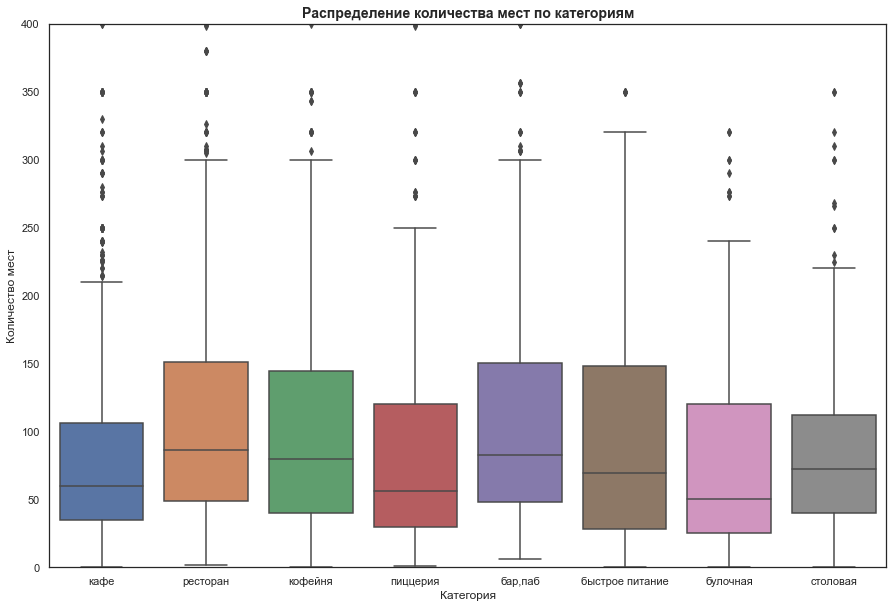

In [62]:
plt.figure(figsize=(15, 10))

sns.boxplot(
    x='category',
    y='seats',
    data=rest_data
)

plt.title('Распределение количества мест по категориям', fontsize=14, fontweight='bold')
plt.xlabel('Категория')
plt.ylabel('Количество мест')
plt.gca().set_ylim([0, 400]);

Судя по графику, во всех категориях 75% заведений имеют менее 150 мест. Наименьший разброс значений демонстрируют такие категории, как кафе и столовая, а наибольший разброс наблюдается у заведений быстрого питания.

Посмотрим на медианы количества мест по категориям:

In [63]:
fig = px.bar(rest_data.groupby('category', as_index=False).agg({
    'seats':
    'median'
}).sort_values(by='seats', ascending=False),
             x='category',
             y='seats',
             text='seats',
             title='Распределение медианных значений количества мест по категориям',
             template='simple_white',
             labels={
                 'category': 'Категория',
                 'seats': 'Медианное количество мест'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(title_pad_l=150)

fig.show()

Больше всего мест в среднем (по медиане) в ресторанах — 86. По количеству мест к ресторанам близки бары/пабы и кофейни. Примерно одинаковое количество мест в заведениях быстрого питания и столовых — около 70. Меньше всего мест обычно в кафе, пиццериях и булочных (50–60 мест). 

Сравним средние рейтинги по категориям заведений:

In [64]:
ratings_by_cat = (rest_data.groupby('category', as_index=False).agg({
    'rating':
    'mean'
}).sort_values(by='rating', ascending=False))

ratings_by_cat['rating'] = round(ratings_by_cat['rating'], 2)

fig = px.bar(ratings_by_cat,
             x='category',
             y='rating',
             text='rating',
             title='Средние рейтинги категорий заведений',
             template='simple_white',
             labels={
                 'category': 'Категория',
                 'rating': 'Средний рейтинг'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(title_pad_l=240,
                 yaxis_range=[4, 4.5])

fig.show()

В целом нельзя сказать, что усреднённые рейтинги сильно различаются в зависимости от категории. Большая часть находится в диапазоне 4,2–4,3. Выбиваются только бары (4,39), кафе (4,15) и заведения быстрого питания (4,06). 

<a id='24/7'></a>
Вычислим и визуализируем доли круглосуточных заведений в каждой категории:

In [65]:
rests_by_working_hours_cat = (rest_data.reset_index().groupby(
    ['category', 'is_24/7'], as_index=False).agg({
        'index': 'count'
    }).rename(columns={'index': 'rest_cnt'}))

rests_by_working_hours_cat['is_24/7'] = (
    rests_by_working_hours_cat['is_24/7'].map({
        False: 'некруглосуточные',
        True: 'круглосуточные'
    }))


def calculate_type_share(row, df):
    cat_total = int(df.loc[df['category'] == row['category'],
                           'rest_cnt'].sum())
    result = row['rest_cnt'] / cat_total
    return f"{result:.0%}", result * 100


rests_by_working_hours_cat['type_share_%'] = rests_by_working_hours_cat.apply(
    axis=1,
    func=lambda x: calculate_type_share(x, rests_by_working_hours_cat)[0])

fig = px.bar(
    rests_by_working_hours_cat,
    x='rest_cnt',
    y='category',
    color='is_24/7',
    text='type_share_%',
    title=
    'Соотношение числа круглосуточных и некруглосуточных заведений по категориям',
    labels={
        'rest_cnt': 'Количество заведений',
        'category': 'Категория',
        'type_share': 'Доля в категории'
    },
    color_discrete_sequence=px.colors.qualitative.Set2,
    template='simple_white')

fig.update_layout(title_pad_l=100,
                  yaxis_categoryorder='total ascending',
                  legend=dict(title='Категория заведения:',
                              orientation='h',
                              yanchor='bottom',
                              y=.02,
                              xanchor='right',
                              x=1))

fig.show()

Некруглосуточных заведений ожидаемо больше, чем круглосуточных. Большой процент круглосуточных заведений только в категории быстрого питания — 27% (скорее всего, это всяческие мелкие шавермичные). Сравнительно часто круглосуточными бывают также кафе и булочные — в 13% и 10% случаев соответственно. Реже всего круглосуточными являются кофейни и столовые — в этих категориях некруглосуточные заведения составляют около 96%.

Теперь посмотрим на соотношение сетевых и несетевых заведений:

In [66]:
rests_by_chain_status = pd.DataFrame(rest_data['chain'].value_counts())\
    .rename(index={0: 'несетевые', 1: 'сетевые'}, columns={'chain': 'rests_cnt'})\
    .reset_index()

fig = go.Figure(data=[
    go.Pie(labels=rests_by_chain_status['index'],
           values=rests_by_chain_status['rests_cnt'],
           hole=.3)
])

fig.update_layout(title='Соотношение количества сетевых и несетевых заведений',
                  width=800,
                  height=600,
                  title_pad_l=180,
                  annotations=[
                      dict(x=1.23,
                           y=1.05,
                           text='Принадлежность к сети',
                           showarrow=False)
                  ])
fig.update_traces(marker=dict(colors=px.colors.qualitative.Set2))

fig.show()

Несетевых заведений явно больше, чем сетевых, — их доля в общем числе заведений составляет почти 60%.

Выясним, в каких категориях заведения в основном сетевые, а в каких несетевые:

In [67]:
chains_vs_not_chains_by_cat = (rest_data.reset_index().groupby(
    ['category', 'chain'], as_index=False).agg({
        'index': 'count'
    }).rename(columns={'index': 'rest_cnt'}))

chains_vs_not_chains_by_cat['chain'] = (
    chains_vs_not_chains_by_cat['chain'].map({
        0: 'несетевые',
        1: 'сетевые'
    }))

chains_vs_not_chains_by_cat[
    'type_share_%'] = chains_vs_not_chains_by_cat.apply(
        lambda x: calculate_type_share(x, chains_vs_not_chains_by_cat)[0], axis=1)

chains_vs_not_chains_by_cat[
    'type_share_raw'] = chains_vs_not_chains_by_cat.apply(
        lambda x: calculate_type_share(x, chains_vs_not_chains_by_cat)[1], axis=1)

fig = px.bar(
    chains_vs_not_chains_by_cat,
    x='rest_cnt',
    y='category',
    color='chain',
    text='type_share_%',
    title='Соотношение числа сетевых и несетевых заведений по категориям',
    labels={
        'chain': 'Принадлежность к сети',
        'rest_cnt': 'Количество заведений',
        'category': 'Категория',
        'type_share_%': 'Доля в категории'
    },
    color_discrete_sequence=px.colors.qualitative.Set2,
    template='simple_white')

fig.update_layout(title_pad_l=180,
                  yaxis_categoryorder='total ascending',
                  legend=dict(title='Категория заведения:',
                              orientation='h',
                              yanchor='bottom',
                              y=.02,
                              xanchor='right',
                              x=1))

fig.show()

Пиццерии, кофейни и булочные чаще являются сетевыми, чем несетевыми. Для всех остальных категорий заведений соотношение обратное: они чаще несетевые, чем сетевые.

Посмотрим повнимательнее, заведения какого типа чаще оказываются сетевыми:

In [68]:
fig = px.bar(chains_vs_not_chains_by_cat.query('chain == "сетевые"'),
             x='category',
             y='type_share_raw',
             text='type_share_%',
             title='Доли сетевых заведений по категориям',
             labels={
                 'category': 'Категория',
                 'type_share_%': 'Доля в категории',
                 'type_share_raw': 'Доля в категории, %'
             },
             template='simple_white')

fig.update_layout(title_pad_l=280, xaxis_categoryorder='total descending')

fig.update_traces(marker_color='#fc8d62')

fig.show()

Как уже говорилось выше, самое большая доля сетевых заведений в категориях булочная, пиццерия и кофейня, а наименьшая — среди столовых и баров.

Визуализируем данные о 15 самых популярных сетях в Москве. О популярности мы будем судить по количеству заведений:

In [69]:
top15_chains = (rest_data.reset_index().groupby('name', as_index=False).agg({
    'index':
    'count',
    'category':
    'first',
    'price':
    'first'
}).rename(columns={
    'index': 'rest_cnt'
}).sort_values(by='rest_cnt').tail(15))

fig = px.bar(top15_chains,
             x='rest_cnt',
             y='name',
             color='category',
             text='rest_cnt',
             title='Топ-15 сетей в Москве по категориям',
             labels={
                 'rest_cnt': 'Количество заведений',
                 'name': 'Название сети'
             },
             color_discrete_sequence=px.colors.qualitative.Set2,
             template='simple_white')

fig.update_layout(yaxis_categoryorder='total ascending',
                  title_pad_l=340,
                  legend=dict(title='Категория',
                              yanchor='bottom',
                              y=0.5,
                              xanchor='right',
                              x=0.95))

fig.show()

Самое большое количество заведений у сети «Шоколадница» — 119. У всех остальных заведений значительно меньше — не более 76.

К 15 крупнейшим сетям относятся кофейни, пиццерии, рестораны и кафе. Также есть одна крупная сеть булочных. В целом подобное распределение по категориям кажется вполне обычным. Хотя вот ресторанов быстрого питания вроде «Макдоналдс» / «Вкусно и точка» не хватает. Не понятно, куда делись все эти сети из датасета.
 
Все представленные сети объединяет, пожалуй, относительно невысокая ценовая категория. Проверим это утверждение:

In [70]:
top15_chains['price'].value_counts()

низкие     12
средние     2
Name: price, dtype: int64

Наша гипотеза подтверждается. Все представленные сети — в основном дешёвые.

Посмотрим, как заведения в топ-15 сетей Москвы распределяются по категориям:

In [71]:
top15_chains_categories = top15_chains.groupby('category', as_index=False).agg(
    {'rest_cnt': 'sum'})

fig = px.bar(top15_chains_categories,
             x='category',
             y='rest_cnt',
             text='rest_cnt',
             title='Распределение по категориям среди заведений из топ-15 сетей Москвы',
             labels={
                 'category': 'Категория',
                 'rest_cnt': 'Количество заведений'
             },
             template='simple_white')

fig.update_layout(title_pad_l=120, xaxis_categoryorder='total descending')

fig.update_traces(marker_color='#fc8d62')

fig.show()

Больше всего заведений в топ-15 сетей относится к категории кофеен — 330 штук. В категориях «ресторан», «пиццерия» и «кафе» количество примерно одинаковое — между 130 и 150. Меньше всего в топ-15 булочных.

Для наглядности визуализируем также, как распределяются по категориям сами сети, а не их заведения:

In [72]:
top15_chains_categories_cnt = top15_chains.groupby('category', as_index=False).agg(
    {'rest_cnt': 'count'})

fig = px.bar(top15_chains_categories_cnt,
             x='category',
             y='rest_cnt',
             text='rest_cnt',
             title='Распределения по категориям топ-15 сетей Москвы',
             labels={
                 'category': 'Категория',
                 'rest_cnt': 'Количество сетей'
             },
             template='simple_white')

fig.update_layout(title_pad_l=200, xaxis_categoryorder='total descending')

fig.update_traces(marker_color='#fc8d62')

fig.show()

График выше наглядно демонстрирует, что больше всего сетей (пять) из топ-15 относятся к категории «кофейня», а меньше всего (лишь одна) — к категории «булочная».

Из анализа двух вышеприведённых графиков можно сделать общий вывод, что наибольшие перспективы формирования действительно крупных сетей в Москве имеют кофейни.

**Краткие выводы:**

- самые распространённые категории — кафе, ресторан и кофейня;


- самое большое количество мест обычно в ресторанах, барах и кофейнях, а самое маленькое — в кафе, пиццериях и булочных;


- круглосуточными чаще всего являются заведения быстрого питания, а реже всего — кофейни и столовые;


- средние рейтинги всех категорий заведений похожи и в основном находятся в диапазоне от 4,2 до 4,3;


- заведения в датасете чаще несетевые, чем сетевые, при этом сетевыми заведениями чаще оказываются кафе, кофейни и рестораны;


- к самым популярным сетевым заведениям относятся в основном кофейни (к этой категории относится больше всего заведений из крупных сетей), кафе, пиццерии и рестораны, все они характеризуются низким или средним уровнем цен.

### Особенности географического распределения заведений

<a id='rests_by_districts'></a>
Теперь посмотрим, как распределяются заведения по районам:

In [73]:
rests_by_district_and_cat = (rest_data.reset_index().groupby(
    ['district_short', 'category'], as_index=False).agg({
        'index': 'count'
    }).rename(columns={'index': 'rest_cnt'}))

rests_by_district = (rest_data.reset_index().groupby(
    ['district_short'], as_index=False).agg({
        'index': 'count'
    }).rename(columns={'index': 'rest_cnt'}))


def calculate_cat_share(row):
    district_total = int(rests_by_district.loc[
        rests_by_district['district_short'] == row['district_short'],
        'rest_cnt'])
    result = row['rest_cnt'] / district_total
    return f"{result:.0%}"


rests_by_district_and_cat['cat_share'] = rests_by_district_and_cat.apply(
    calculate_cat_share, axis=1)

fig = px.bar(rests_by_district_and_cat,
             x='district_short',
             y='rest_cnt',
             color='category',
             text='cat_share',
             title='Распределение заведений по районам и категориям',
             labels={
                 'category': 'Категория',
                 'rest_cnt': 'Количество заведений',
                 'name': 'Название сети',
                 'district_short': 'Административный округ',
                 'cat_share': 'Доля от общего числа заведений в районе'
             },
             color_discrete_sequence=px.colors.qualitative.Set2,
             template='simple_white')

fig.update_layout(title_pad_l=180,
                  height=800,
                  xaxis_categoryorder='total descending',
                  uniformtext_minsize=10,
                  uniformtext_mode='hide',
                  legend=dict(title='Категория',
                              yanchor='top',
                              y=0.95,
                              xanchor='right',
                              x=1))
fig.show()

В целом в датасете представлены следующие административные округа: Центральный, Северный, Северо-Западный, Западный, Юго-Западный, Южный, Юго-Восточный, Восточный, Северо-Восточный. 

Больше всего заведений расположены в ЦАО (ожидаемо) — их число превышает 2000. В остальных округах их более чем в два раза меньше. Наименьшее количество заведений — в СЗАО. Наверное, потому, что там в основном парки, да и плюс значительная часть находится за МКАДом.

Категориальная структура заведений в ЦАО и остальных районах несколько разная. Так, в ЦАО относительно много баров — 16% —, тогда как во всех остальных районах их не более 8%. Также доля ресторанов в ЦАО самая большая — 29%, а в почти во всех остальных районах она находится в диапазоне 20–24%. Похожее утверждение можно сделать о кофейнях. В то же время кафе и заведений быстрого питания в ЦАО относительно меньше.

Посмотрим, как есть ли различия в средних рейтингах заведений по районам. Отобразим на карте также заведения в виде кластеров:

In [74]:
pth_to_geojson_local = 'admin_level_geomap.geojson'
pth_to_geojson_global = '/datasets/admin_level_geomap.geojson'

if os.path.exists(pth_to_geojson_local):
    state_geo = pth_to_geojson_local
elif os.path.exists(pth_to_geojson_global):
    state_geo = pth_to_geojson_global
else:
    print('Файл с границами административных округов не найден!')

ratings_by_district = (rest_data.groupby('district', as_index=False).agg(
    {'rating': 'mean'}))

In [75]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)

Choropleth(
    geo_data=state_geo,
    data=ratings_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)

rest_data.apply(create_clusters, axis=1)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Средний рейтинг заведений по районам Москвы</b></h3>
             '''
m.get_root().html.add_child(Element(title_html))

m

Самые высокие средние рейтинги — у заведений в ЦАО (ожидаемо: в ЦАО заведений много, и, чтобы там продержаться, надо быть качественным), а самые низкие — в ЮВАО и СВАО. Отметим, что в ЦАО заведений много, так что высокий рейтинг, видимо, является вполне характерной чертой для большниства заведений там.

<a id='top_15_streets'></a>
Найдём 15 самых важных улиц по количеству заведений на них: 

In [76]:
rests_by_streets = (rest_data.reset_index().groupby(
    ['street', 'category'], as_index=False).agg({
        'index': 'count'
    }).rename(columns={'index': 'rest_cnt'}))

rests_by_streets['rest_cnt_total'] = rests_by_streets.apply(
    lambda x: rests_by_streets.loc[rests_by_streets['street'] == x['street'],
                                   'rest_cnt'].sum(),
    axis=1)

rests_by_streets['cat_share'] = (rests_by_streets['rest_cnt'] / rests_by_streets['rest_cnt_total'])\
    .map('{:.0%}'.format)

top15_streets = (rests_by_streets[[
    'street', 'rest_cnt_total'
]].drop_duplicates().sort_values(by='rest_cnt_total',
                                 ascending=False).head(15)['street'])

fig = px.bar(rests_by_streets[rests_by_streets['street'].isin(top15_streets)],
             x='rest_cnt',
             y='street',
             color='category',
             text='cat_share',
             title='Топ-15 улиц в Москве по числу ресторанов',
             labels={
                 'rest_cnt': 'Количество заведений',
                 'category': 'Категория',
                 'street': 'Улица',
                 'cat_share': 'Доля категории в общем числе заведений на улице'
             },
             color_discrete_sequence=px.colors.qualitative.Set2,
             template='simple_white')

fig.update_layout(title_pad_l=180,
                  height=600,
                  yaxis_categoryorder='total ascending',
                  uniformtext_minsize=10,
                  uniformtext_mode='hide',
                  legend=dict(title='Категория',
                              yanchor='top',
                              y=0.90,
                              xanchor='right',
                              x=1))

fig.show()

В целом в топ-15 входят важные и довольно длинные московские улицы. Интересно, что большая часть этих улиц находится за пределами ЦАО. Видимо, в ЦАО заведения разбросаны по относительно небольшим улицам, а не сконцентрированы на крупной магистрали, как это происходит в других районах.

Больше всего заведений находится на проспекте Мира — около 180. На всех остальных улицах в топе заведений меньше как минимум в полтора раза.

Структура заведений по категориям в целом схожая: почти на всех улицах преобладают либо кафе, либо рестораны, либо кофейни, при этом часто их количество сопоставимо. Сильно выделяются по своей структуре только МКАД (66% кафе) и Люблинская улица (41% ресторанов).

Посмотрим на карте заведения, которые являются единственными на своей улице:

In [77]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)

marker_cluster = MarkerCluster().add_to(m)

rest_data[
    rest_data['street'].isin(rests_by_streets.query(
        'rest_cnt_total == 1')['street'])
]\
    .apply(create_clusters, axis=1)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Единственные заведения на улице</b></h3>
             '''
m.get_root().html.add_child(Element(title_html))

m

Такие заведения, получается, сконцентрированы в центре. Это неудивительно, ведь в центре много небольших улиц, на которых больше одного заведения и не поместится. Также немало таких заведений в районе парков.

Теперь изучим зависимость величины среднего чека от района. Сначала построим диаграмму `stripplot` по районам:

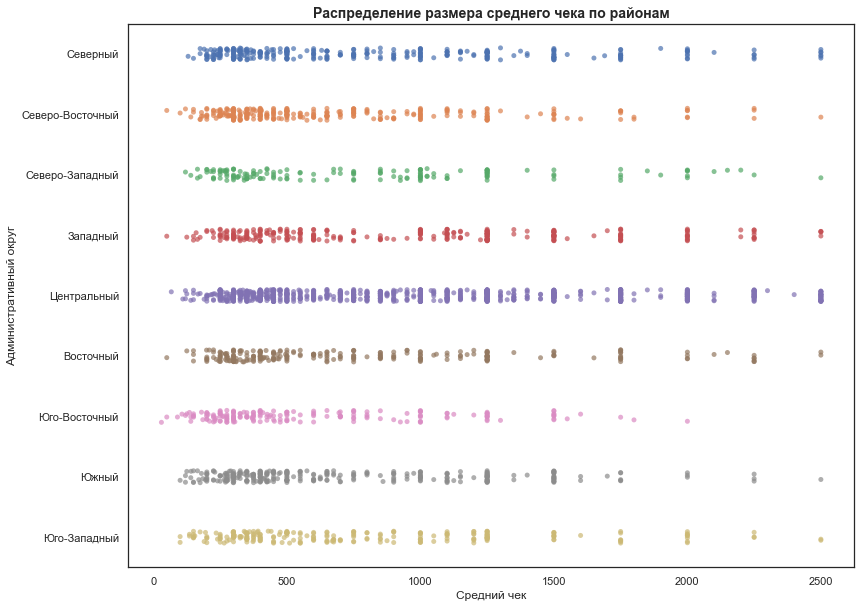

In [78]:
plt.figure(figsize=(13, 10))

sns.stripplot(y='district_short',
              x='middle_avg_bill',
              data=rest_data,
              alpha=0.7)

plt.title('Распределение размера среднего чека по районам',
          fontsize=14,
          weight='bold')

plt.xlabel('Средний чек')
plt.ylabel('Административный округ');

По размеру среднего чека хорошо выделяется ЦАО. В меньшей степени — СЗАО, САО и ЗАО. Но это не точно — диаграмма `stripplot` в данном случае оказалась не очень удобной для анализа. Пожалуй, будет удобнее исследовать взаимосвязь, используя медианные значения среднего чека по районам. Нанесём их на хороплет.

In [79]:
bills_by_district = (rest_data.groupby('district', as_index=False).agg(
    {'middle_avg_bill': 'median'}))

m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)

Choropleth(
    geo_data=state_geo,
    data=bills_by_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Медианные средний чек по районам',
).add_to(m)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Медианный средний чек по районам Москвы</b></h3>
             '''
m.get_root().html.add_child(Element(title_html))

m

На фоновой картограмме различия в средних чеках между районами видны гораздо лучше. Выходит, ЦАО и ЗАО — самые дорогие районы. С ЦАО всё совсем очевидно. С ЗАО в целом тоже — это в принципе в значительной степени элитный район. Самые дешёвые районы — САО, ЮВАО и ЮАО.

Теперь посмотрим, как меняется средний чек по мере удаления от центра. Для этого сначала рассчитаем расстояния от центра до каждого заведения через гаверсинус (функция `calculate_dist_from_center`). Затем построим диаграмму совместного распределения расстояния до центра и среднего чека:

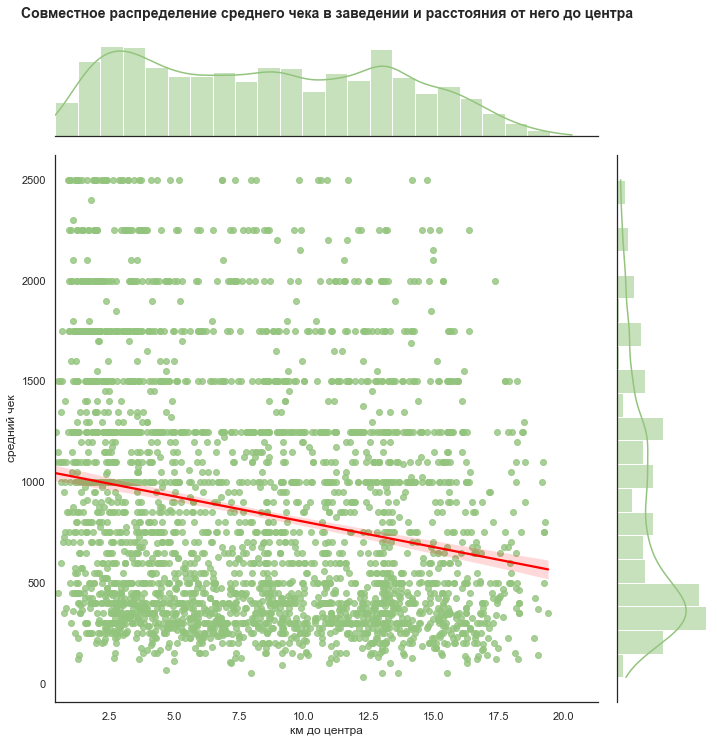

In [80]:
moscow_lng_rad = mth.radians(moscow_lng)
moscow_lat_rad = mth.radians(moscow_lat)


def calculate_dist_from_center(row):

    lng = mth.radians(row['lng'])
    lat = mth.radians(row['lat'])

    dlng = lng - moscow_lng_rad
    dlat = lat - moscow_lat_rad
    a = mth.sin(dlat / 2)**2 + mth.cos(lat) * \
        mth.cos(moscow_lat_rad) * mth.sin(dlng / 2)**2

    c = 2 * mth.asin(mth.sqrt(a))

    r = 6371  # радиус Земли в км

    return (c * r)


rest_data['km_from_center'] = rest_data.apply(calculate_dist_from_center,
                                              axis=1)

p = sns.jointplot(x='km_from_center',
                  y='middle_avg_bill',
                  data=rest_data,
                  kind='reg',
                  height=10,
                  line_kws={"color": "red"},
                  color='#93c47d')

plt.suptitle(
    'Совместное распределение среднего чека в заведении и расстояния от него до центра',
    y=1.03,
    x=0.45,
    fontweight='bold',
    fontsize=14)

p.set_axis_labels('км до центра', 'средний чек', fontsize=12);

Средний чек ожидаемо уменьшается по мере удаления от центра. Иными словами, чем дальше от центра, тем цены ниже.

**Краткие выводы**:

- больше всего заведений — в ЦАО, их категориальная структура в этом районе несколько отличается от категориальной структуры в других районах;


- самый высокий средний рейтинг заведений — тоже в ЦАО, а самый низкий — в СВАО и ЮВАО;


- в топ-15 улиц по количеству заведений входят оживлённые и довольно длинные магистрали, в их категориальной структуре преобладают кафе, рестораны и кофейни, иная ситуация наблюдается лишь на МКАДе и, в меньшей степени, на Люблинской улице;


- улицы, на которых расположено только одно заведение, сконцентрированы в центре Москвы;


- самый большой медианный средний чек — в ЦАО и ЗАО, а самый маленький — в ЮВАО, ЮАО и САО;


- размер среднего чека уменьшается по мере удаления от центра.

## Определение основных характеристик для новой кофейни

### Географическое распределение кофеен

Проанализируем ситуацию с кофейнями в Москве и на этом основании сформулируем рекомендации по открытию такого рода заведений.

Для начала посмотрим, сколько всего кофеен в датасете:

In [81]:
print('Кофеен в датасете:', rest_data.query('category == "кофейня"').shape[0])
print(
    'Доля кофеен в датасете:',
    round(
        rest_data.query('category == "кофейня"').shape[0] / rest_data.shape[0],
        4) * 100, '%')

Кофеен в датасете: 1396
Доля кофеен в датасете: 18.09 %


Кофейня — довольно распространённый тип заведений, и их много в Москве. Выясним, как они распределены по районам:

In [82]:
coffee_houses_by_district = (rest_data.query('category == "кофейня"').groupby(
    'district_short', as_index=False).agg({
        'name': 'count'
    }).rename(columns={'name': 'rest_cnt'}))

fig = px.bar(coffee_houses_by_district,
             x='rest_cnt',
             y='district_short',
             text='rest_cnt',
             title='Количество кофеен по районам',
             template='simple_white',
             labels={
                 'rest_cnt': 'Количество кофеен',
                 'district_short': 'Административный округ'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(yaxis_categoryorder='total ascending', title_pad_l=250)

fig.show()

Количество кофеен распределено по районам примерно так же, как [распределяются](#rests_by_districts) по районам все заведения в целом: больше всего в ЦАО, в остальных районах меньше как минимум в два раза. На втором и третьем местах САО и СВАО. Меньше всего в СЗАО.

Найдём 15 улиц, на которых больше всего кофеен:

In [83]:
coffee_houses_by_streets = (rest_data.query('category == "кофейня"').groupby(
    'street', as_index=False).agg({
        'name': 'count'
    }).rename(columns={'name': 'rest_cnt'}))

fig = px.bar(coffee_houses_by_streets.sort_values(by='rest_cnt').tail(15),
             x='rest_cnt',
             y='street',
             text='rest_cnt',
             title='Топ-15 улиц по количеству кофеен',
             template='simple_white',
             labels={
                 'rest_cnt': 'Количество кофеен',
                 'street': 'Улица'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(yaxis_categoryorder='total ascending',
                  title_pad_l=250,
                  height=600)

fig.show()

В топ-15 видим почти все те же улицы, что были в общем [топе-15](#top_15_streets) улиц по числу заведений. Не зватает разве что МКАДа, Пятницкой улицы и улицы Миклухо-Маклая.
Больше всего кофеен на проспекте Мира, примерно в полтора раза меньше на Ленинградского и Ленинском проспектах. На остальных улицах число кофеен не превышает 18.

Теперь выясним, какие улицы являются «самыми кофейными», т.е. на каких улицах доля кофеен самая большая. Будем рассматривать только те улицы, на которых в принципе больше 15 заведений.

In [84]:
rests_by_streets['cat_share_percent'] = rests_by_streets['cat_share'].map(
    lambda x: float(x.strip('%')))

rests_by_streets['cat_share_str'] = rests_by_streets.apply(
    lambda x: f'{x["rest_cnt"]} из {x["rest_cnt_total"]}', axis=1)

top15_coffee_streets = (rests_by_streets.query(
    'category == "кофейня" and rest_cnt_total > 10').sort_values(
        by='cat_share_percent').tail(15))

fig = px.bar(top15_coffee_streets,
             x='cat_share_percent',
             y='street',
             text='cat_share_str',
             title='Топ-15 улиц по доле кофеен',
             template='simple_white',
             labels={
                 'cat_share_percent': 'Доля кофеен',
                 'street': 'Улица',
                 'cat_share_str': 'Число кофеен из общего числа заведений'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(yaxis_categoryorder='total ascending',
                  title_pad_l=250,
                  height=600)

fig.show()

«Самая кофейная» улица из тех, на которых в принципе больше 10 заведений, — Сельскохозяйственная улица. Там более 50% кофеен. Более 40% кофеен на улицах Большая Полянка, Береговой проезд, Бутырская, Мосфильмовская, Большой Саввинский переулок и Головинское шоссе.

<a id='least_coffee_streets'></a>
А теперь «наименее кофейные» улицы с числом заведений более 10:

In [85]:
antitop15_coffee_streets = (rests_by_streets.query(
    'category == "кофейня" and rest_cnt_total > 10').sort_values(
        by='cat_share_percent').head(15))

fig = px.bar(antitop15_coffee_streets,
             x='cat_share_percent',
             y='street',
             text='cat_share_str',
             title='15 улиц с наименьшей долей кофеен',
             template='simple_white',
             labels={
                 'cat_share_percent': 'Доля кофеен',
                 'street': 'Улица',
                 'cat_share_str': 'Число кофеен из общего числа заведений'
             },
             color_discrete_sequence=px.colors.qualitative.Set2)

fig.update_layout(yaxis_categoryorder='total descending',
                  title_pad_l=250,
                  height=600)

fig.show()

Самая маленькая доля кофеен — на Малой Бронной улице. В глаза бросается также улица из топ-15 по количеству заведений — МКАД. Там очень мало кофеен.

Поищем закономерность в расположении самых «кофейных» и самых «некофейных» улиц. Нанесём на карту расположенные по одной кофейне с каждой такой улицы. Синими звёздочками отметим кофейни на самых «кофейных» улицах, а чёрными — на самых «некофейных».

In [86]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)

icon_top15_url = 'https://img.icons8.com/fluency/512/starburst-shape.png'
icon_antitop15_url = 'https://img.icons8.com/ios/512/starburst-shape.png'


def create_marker(row, icon_url):

    icon = CustomIcon(icon_url, icon_size=(20, 20))

    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon,
    ).add_to(m)


rests_from_top_streets = rest_data[
    (rest_data['street'].isin(top15_coffee_streets['street']))
    & (rest_data['category'] == 'кофейня')].groupby('street').agg({
        'name': 'first',
        'lat': 'first',
        'lng': 'first'
    })

rests_from_antitop_streets = rest_data[
    (rest_data['street'].isin(antitop15_coffee_streets['street']))
    & (rest_data['category'] == 'кофейня')].groupby('street').agg({
        'name': 'first',
        'lat': 'first',
        'lng': 'first'
    })

rests_from_top_streets.apply(create_marker, icon_url=icon_top15_url, axis=1)
rests_from_antitop_streets.apply(create_marker,
                                 icon_url=icon_antitop15_url,
                                 axis=1)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Кофейни на улицах с наибольшей и наименьшей долей кофеен</b></h3>
             '''
m.get_root().html.add_child(Element(title_html))

m

По этой карте можно сделать вывод, что самые «кофейные» улицы сконцентрированы находятся в основном в центре или очень близко к нему (близко к Третьему транспортному кольцу). Много их и в в САО. В то же время улицы с небольшим количеством кофеен чуть ближе к окраинам (юг и восток). Получается, стоит рассмотреть нецентральные районы для размещения в них кофейни. При этом совсем на окраину уходить явно нет смысла. Плюс лучше искать оживлённые улицы (хорошие кандидаты — Нахимовский проспект, Мытная улица и Багратионовский проезд, хотя и другие улицы с небольшой долей кофеен подойдут).

### Круглосуточные кофейни

Посмотрим ещё раз, много ли круглосуточных кофеен в датасете:

In [87]:
coffee_by_working_hours = pd.DataFrame(rest_data.query('category == "кофейня"')['is_24/7'].value_counts())\
    .rename(index={False: 'некруглосуточные', 1: 'круглосуточные'}, columns={'is_24/7': 'rests_cnt'})\
    .reset_index()

fig = go.Figure(data=[
    go.Pie(labels=coffee_by_working_hours['index'],
           values=coffee_by_working_hours['rests_cnt'],
           hole=.3)
])

fig.update_layout(title='Соотношение количества круглосуточных и некруглосуточных кофеен',
                  width=800,
                  height=600,
                  title_pad_l=100,
                  annotations=[
                      dict(x=1.23,
                           y=1.05,
                           text='Режим работы',
                           showarrow=False)
                  ])
fig.update_traces(marker=dict(colors=px.colors.qualitative.Set2))

fig.show()


Круглосуточных кофеен всего 4%. Это, как мы [видели](#24/7) ранее, очень мало. Получается, круглосуточных кофеен мало. Возможно, это перспективная ниша. Хотя и не аутентично — Central Perk не был круглосуточной кофейней. И всё-таки стоит провести более глубокий анализ денежных потоков, чтобы быть уверенным в том, что работа ночью будет окупаться.

### Рейтинги кофеен

Посмотрим, в каком диапазоне распределены рейтинги кофеен:

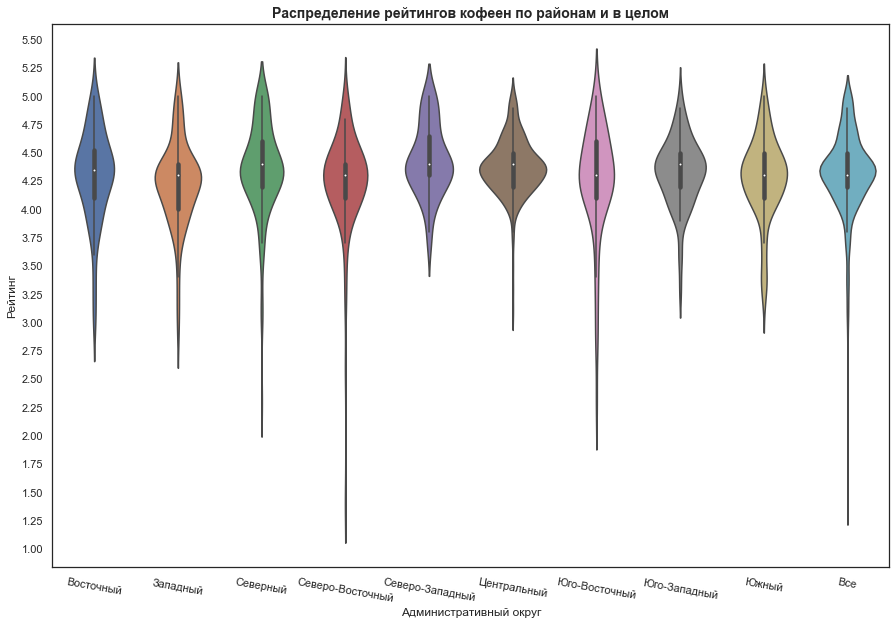

In [88]:
coffee_houses_ratings_by_district = rest_data.query(
    'category == "кофейня"').groupby(['district_short', 'name'],
                                     as_index=False).agg({'rating': 'first'})

coffee_houses_ratings_by_district = pd.concat([
    coffee_houses_ratings_by_district,
    pd.DataFrame({
        'district_short': 'Все',
        'rating': coffee_houses_ratings_by_district['rating']
    })
])

plt.figure(figsize=(15, 10))
sns.violinplot(x='district_short',
               y='rating',
               data=coffee_houses_ratings_by_district)

plt.gca().yaxis.set_major_locator(MultipleLocator(0.25))

plt.xticks(rotation=-10)
plt.xlabel('Административный округ')
plt.ylabel('Рейтинг')
plt.title('Распределение рейтингов кофеен по районам и в целом',
          fontsize=14,
          fontweight='bold');

В целом большая часть кофеен имеет рейтинг между 4,0 и 4,8. Медианное значение по районам и в целом колеблется в диапазоне примерно от 4,2 до 4,5. Наименьшую дисперсию значений демонстрирует ЦАО (в диапазон примерно от 4,2 до 4,5 укладывается около 50% рейтингов кофеен), тогда как самая большая дисперсия в ЮВАО (около 50% кофеен имеют рейтинг примерно от 4,0 до 4,5). Распределение рейтингов по всей Москве скорее соответствует распределению в ЦАО, во многом потому, что в ЦАО расположено больше всего кофеен, а также потому, что распределения в некоторых других районах также напоминают распределение в ЦАО. В целом дисперсия значений довольно низкая.

Посмотрим, как распределяются средние значения рейтингов кофеен по районам:

In [89]:
avg_coffee_ratings_by_district = (rest_data.query('category == "кофейня"').groupby(
    'district', as_index=False).agg({'rating': 'mean'}))

m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)

Choropleth(
    geo_data=state_geo,
    data=avg_coffee_ratings_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Средние рейтинги по районам',
).add_to(m)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Средние рейтинги кофеен по районам Москвы</b></h3>
             '''
m.get_root().html.add_child(Element(title_html))

m

Относительно высокий средний рейтинг демонстрируют ЦАО и СЗАО. Самые низкие средние рейтинги в ЗАО и СВАО. Пожалуй, там будет самая низкая конкуренция, поэтому стоит рассмотреть именно эти районы для размещения в них кофейни. А планируя основать кофейню в ЦАО и СЗАО, следует основательно подумать о конкурентах. Впрочем, различия в средних рейтингах не очень большие между всеми районами. 

### Средние цены кофеен

Теперь определим ориентировочную цену чашки капучино для новой кофейни. Посмотрим на распределение цен кофе на графике-скрипке:

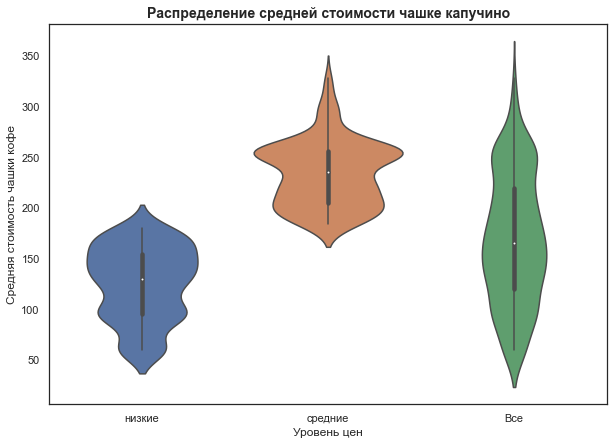

In [90]:
avg_middle_coffee_cup_by_price = rest_data.query(
    'category == "кофейня" and (price == "низкие" or price == "средние")')[[
        'price', 'middle_coffee_cup'
    ]]

avg_middle_coffee_cup_by_price = pd.concat([
    avg_middle_coffee_cup_by_price,
    pd.DataFrame({
        'price':
        'Все',
        'middle_coffee_cup':
        avg_middle_coffee_cup_by_price['middle_coffee_cup']
    })
])

plt.figure(figsize=(10, 7))

sns.violinplot(x='price',
               y='middle_coffee_cup',
               data=avg_middle_coffee_cup_by_price)

plt.xlabel('Уровень цен')
plt.ylabel('Средняя стоимость чашки кофе')
plt.title('Распределение средней стоимости чашке капучино',
          fontsize=14,
          fontweight='bold');

Распределение средних стомостей в целом имеет два пика — певрвый в районе 150 рублей, а второй в районе 250 рублей. Один — больший — связан главным образом с кофейнями нижнего ценового уровня, а другой — меньший — возникает из-за кофеен среднего ценового уровня. Это неудивительно, поскольку в нижнем сегменте кофеен больше, чем в среднем.

Судя по распределению цен, рентабельность обеспечивается в диапазоне примерно от 100 до 270 рублей за чашку капучино. Правда, стоит учитывать, что за 100 рублей и за 270 рублей капучино будет разного качества.

В кофейне Central Perk, кажется, кофе довольно дешёвый — около 80 рублей за чашку фильтр-кофе (если принять верной расчётную цену 1 чашки фильтр-кофе в 1,5 доллара США, найденную Madison Flager в статье на сайте [delishe](https://www.delish.com/food-news/news/a54075/how-much-coffee-the-friends-cast-drank/), а затем [пересчитать](https://www.in2013dollars.com/us/inflation/1995) её на цены 2022 года с цен 1995 года и [перевести](https://data.oecd.org/conversion/purchasing-power-parities-ppp.htm#indicator-chart) в рубли по паритету покупательной способности). Капучино в таком случае должно стоить вряд ли больше 120 рублей. Так что, если ориентироваться на оригинальное заведение, цену за чашку не следует устанавливать выше 150 рублей.

Если же исходить из экономических соображений, то тогда необходимо принимать во внимание большое количество факторов и проводить полноценный экономический анализ. В рамках имеющихся данных мы можем учесть цены в районе, в котором будет размещаться заведение. Для привлечения клиентов можно попробовать установить цены в кофейне ниже среднего уровня по району (или по улице, но в рамках данного проекта мы это рассчитывать не будем, поскольку он и так уже превысил все допустимые объёмы).

Построим фоновую картограмму, на которой отразим средние цены по районам (можно брать среднее, поскольку дисперсия цен на кофе невысокая): 

In [91]:
avg_coffee_cups_by_district = (rest_data.query('category == "кофейня"').groupby(
    'district', as_index=False).agg({'middle_coffee_cup': 'mean'}))

m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)

Choropleth(
    geo_data=state_geo,
    data=avg_coffee_cups_by_district,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Средняя стоимость чашки',
).add_to(m)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Средняя стоимость чашки капучино по районам</b></h3>
             '''
m.get_root().html.add_child(Element(title_html))

m

Самый дорогой кофе — в ЦАО, ЗАО и ЮЗАО. Самый дешёвый — в ВАО. С учётом предыдущих рассуждений ЗАО кажется благоприятным местом для размещения кофейни — там можно установить цену ниже средней по району (например, за индикативную цену можно принять 150–170 рублей) и при этом не столкнуться с сильной конкуренцией, особенно если разместиться в Багратионовском проезде, где мало конкурентов.

**Краткие выводы:**

- больше всего кофеен — в ЦАО, там же находятся многие самые «кофейные» улицы;


- самые «некофейные» расположены чуть дальше от центра, но в основном не на самой окраине;


- самые низкие средние рейтинги — в ЗАО и СВАО, а самые высокие — в ЦАО и СЗАО, в целом однако различия не очень существенные;


- самые высокие цены — в ЦАО, ЗАО и ЮЗАО; в целом, если разместиться в ЗАО, можно ориентироваться на цену за чашку кофе в районе 150-170 рублей — так можно и сохранить дух Central Perk, и не столкнуться с большим количеством конкурентов.

## Выводы и рекомендации

**Выполненные в ходе проекта действия и их результаты**:

1. Проведена предобработка данных:

    - устранены неявные дубликаты;

    - исправлены некоторые ошибки (неверный статус принадлежности к сети, неверная ценовая категория);
    
    - удалено небольшое количество артефактов и выбросов;
    
    - удалены или частично заполнены пропуски в двух столбцах;
    
    - добавлены столбцы с улицей заведения, кратким названием района и булевым значением, показывающим, является ли заведение круглосуточным.
    
    
2. Проведён исследовательский анализ данных, в ходе которого были **выявлены основные характеристики рынка общественного питания Москвы**:

    - определены наиболее распространённые категории заведений — кафе, ресторан и кофейня — и характеристики распределения мест: больше всего в барах и ресторанах, а меньше всего — в пиццериях, кафе и булочных;
    
    - установлено преобладание несетевых заведений над сетевыми;
    
    - выявлены наиболее популярные сети — среди них самыми важными являются сети кофеен — и их характерный признак — относительно низкий уровень цен;
    
    - обнаружено, что средний рейтинг заведений в Москве в основном укладывается в диапазон от 4,2 до 4,3, различия между категориями относительно невелики;
    
    - установлено, что круглосуточными чаще всего являются заведения быстрого питания;
    
    - выявлены особенности географического распределения заведений — больше всего заведений в ЦАО, у них самые высокие рейтинги и средний чек, при этом средний чек убывает по мере удаления от центра;
    
    - определены 15 самых популярных улиц и категориальная структура расположенных на них заведений.
    
    
3. Проведено детальное исследование сегмента кофеен:

    - установлены особенности размещения заведений данной категории — самые «кофейные» улицы сосредоточены в основном в центре, а самые «некофейные» тяготеют к периферии;
    
    - рейтинги кофеен распределены в диапазоне от 4,0 до 4,8, основная масса находится между 4,2 и 4,5;
    
    - рентабельные цены за чашку кофе находятся в диапазоне примерно от 100 до 270 рублей за чашку капучино, при это существуют заметные различия в ценах по районам.


**Рекомендации** для инвесторов, планирующих открыть кофейню в стиле Central Perk:

1. Место для размещения:

    - любой район, кроме ЦАО, но наиболее привлекателен ЗАО в силу относительно небольшого количества потенциальных «сильных» конкурентов и высокого среднего чека, за счёт чего можно было бы привлекать клиентов сравнительно более низкими и в то же время рентабельными ценами;
    
    - улица для размещения: одна из [15 улиц с наименьшей долей кофеен](#least_coffee_streets), желательно не совсем на периферии (хороший вариант — Багратионовский проезд)
    
    
2. Режим работы — круглосуточный, однако здесь необходим более детальный анализ влияния часов работы на среднюю выручку и прибыль.


3. Средняя цена за чашку капучино — в районе 150-170 рублей (ценовая категория — низкая), правда, здесь тоже необходим более детальный анализ структуры себестоимости, взаимосвязи цены и посещаемости и т.д.


4. Принадлежность к сети — лучше начать с несетевого статуса, затем, если идея будет успешной, можно развернуться в сеть, как это часто бывает с кофейнями.